# Booking reviews.
 
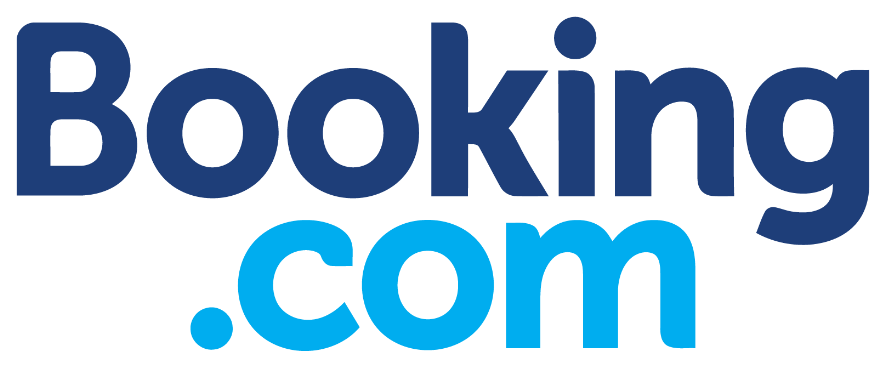

## КАКОЙ КЕЙС РЕШАЕМ?
Представьте, что вы работаете датасаентистом в компании Booking. Одна из проблем компании — это нечестные отели, которые накручивают себе рейтинг. Одним из способов нахождения таких отелей является построение модели, которая предсказывает рейтинг отеля. Если предсказания модели сильно отличаются от фактического результата, то, возможно, отель играет нечестно, и его стоит проверить.
Наша задача создать такую модель.

## Признаки
<ul>
<li><code>hotel_address</code> - адрес отеля</li>
<li><code>review_date</code> - дата, когда рецензент разместил соответствующий отзыв.</li>
<li><code>average_score</code> - средний балл отеля, рассчитанный на основе последнего комментария за последний год</li>
<li><code>hotel_name</code> - название отеля</li>
<li><code>reviewer_nationality</code> - национальность рецензента</li>
<li><code>negative_review</code> - отрицательный отзыв, который рецензент дал отелю. </li>
<li><code>review_total_negative_word_counts</code> - общее количество слов в отрицательном отзыв</li>
<li><code>positive_review</code> - положительный отзыв, который рецензент дал отелю</li>
<li><code>review_total_positive_word_counts</code> - общее количество слов в положительном отзыве</li>
<li><code>reviewer_score</code> - оценка, которую рецензент поставил отелю на основе своего опыта</li>
<li><code>total_number_of_reviews_reviewer_has_given</code> - количество отзывов, которые рецензенты дали в прошлом</li>
<li><code>total_number_of_reviews</code> - общее количество действительных отзывов об отеле</li>
<li><code>tags</code> - теги, которые рецензент дал отелю.</li>
<li><code>days_since_review</code> - продолжительность между датой проверки и датой очистки</li>
<li><code>additional_number_of_scoring</code> - есть также некоторые гости, которые просто поставили оценку сервису, а не оставили отзыв. Это число указывает, сколько там действительных оценок без проверки.</li>
<li><code>lat</code> - широта отеля</li>
<li><code>lng</code> - долгота отеля</li>
</ul>

In [163]:
%%capture
# QUICK WORKAROUND FOR PROBLEM WITH PANDAS
!pip install -U pandas
!pip install -U scikit-learn
!pip install -U ydata_profiling
!pip install -U geopy
!pip install nltk[twitter] 

In [164]:
import os
import re
import time
from collections import Counter

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# импортируем библиотеки для визуализации
import matplotlib.pyplot as plt
import seaborn as sns 
import plotly.express as px
import plotly.graph_objects as go
%matplotlib inline
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)

# Статистичекские тесты
from scipy.stats import mannwhitneyu
from scipy.stats import spearmanr

# Кодирование признаков
import category_encoders as ce

# Импортируем необходимые библиотеки для создания модели:
from sklearn.ensemble import RandomForestRegressor # инструмент для создания и обучения модели
from sklearn import metrics # инструменты для оценки точности модели

# Инструмент для разделения датасета:
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import f_classif

# Для красивого оформления
from colorama import Fore, Back, Style

# Для быстрого преварительного анализа данных
from ydata_profiling import ProfileReport

from nltk.sentiment.vader import SentimentIntensityAnalyzer
import nltk
nltk.downloader.download('vader_lexicon')

# Для работы с координатами
from geopy.geocoders import Nominatim
from geopy.distance import geodesic

#Масштабирование признаков
from sklearn.preprocessing import StandardScaler


from catboost import CatBoostRegressor

# Вывод рабочих директорий
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /usr/share/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
/kaggle/input/dataset/datasets/country_centroids.csv
/kaggle/input/dataset/datasets/country_centroids_complete.csv
/kaggle/input/dataset/datasets/UN_refugees.csv
/kaggle/input/dataset/datasets/country_finances.csv
/kaggle/input/dataset/datasets/Other/displacement_worldbank.csv
/kaggle/input/dataset/datasets/Other/country_regions.csv
/kaggle/input/dataset/datasets/Other/gwn_to_iso3c.csv
/kaggle/input/dataset/datasets/Other/population.csv
/kaggle/input/dataset/datasets/Other/total-affected-natural-disasters.csv
/kaggle/input/dataset/datasets/Other/GDP_worldbank.csv
/kaggle/input/dataset/datasets/Conflicts/ucdp-onesided-201.csv
/kaggle/input/dataset/datasets/Conflicts/ucdp-prio-acd-201.csv
/kaggle/input/dataset/datasets/Conflicts/ged201.csv
/kaggle/input/dataset/datasets/Resettlement/RSQDepartures_America.csv
/kaggle/input/dataset/datasets/Res

In [165]:
# Увеличим чило точек на дюйм, чтобы повысить четкость графиков
sns.set(rc={"figure.dpi":200, 'savefig.dpi':200})
#  И зададим цветовую тему
sns.set_style('whitegrid')

In [166]:
# всегда фиксируйте RANDOM_SEED, чтобы ваши эксперименты были воспроизводимы!
RANDOM_SEED = 42
# зафиксируем версию пакетов, чтобы эксперименты были воспроизводимы:
!pip freeze > requirements.txt

---

# Загрузка данных

In [167]:
# Подгрузим наши данные из соревнования

DATA_DIR = '/kaggle/input/sf-booking/'
df_train = pd.read_csv(DATA_DIR+'/hotels_train.csv') # датасет для обучения
df_test = pd.read_csv(DATA_DIR+'hotels_test.csv') # датасет для предсказания
sample_submission = pd.read_csv(DATA_DIR+'/submission.csv') # самбмишн

In [168]:
# ВАЖНО! дря корректной обработки признаков объединяем трейн и тест в один датасет
df_train['sample'] = 1 # помечаем где у нас трейн
df_test['sample'] = 0 # помечаем где у нас тест
df_test['reviewer_score'] = 0 # в тесте у нас нет значения reviewer_score, мы его должны предсказать, по этому пока просто заполняем нулями

data = pd.concat([df_train, df_test], ignore_index = True) # объединяем
drop_columns = []  # список куда будем вносить ненужные отработаные признаки

In [169]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 515738 entries, 0 to 515737
Data columns (total 18 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   hotel_address                               515738 non-null  object 
 1   additional_number_of_scoring                515738 non-null  int64  
 2   review_date                                 515738 non-null  object 
 3   average_score                               515738 non-null  float64
 4   hotel_name                                  515738 non-null  object 
 5   reviewer_nationality                        515738 non-null  object 
 6   negative_review                             515738 non-null  object 
 7   review_total_negative_word_counts           515738 non-null  int64  
 8   total_number_of_reviews                     515738 non-null  int64  
 9   positive_review                             515738 non-null  object 
 

---

# Исследование данных и очистка от дубликатов.

Используем возможности библиотеки ydata profiling для предворительной оценки признаков.

In [170]:
report = ProfileReport(data)
report

По сгенерированному отчету, первое на что обращаем внимание это **наличие дубликатов**, сразу удалим их.

In [171]:
duplic = data.loc[data['sample'] == 1].duplicated()
ind = duplic[duplic == True].index
print(f'удалено {len(ind)} дубликатов')
data = data.drop(ind)
data.info()

удалено 307 дубликатов
<class 'pandas.core.frame.DataFrame'>
Int64Index: 515431 entries, 0 to 515737
Data columns (total 18 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   hotel_address                               515431 non-null  object 
 1   additional_number_of_scoring                515431 non-null  int64  
 2   review_date                                 515431 non-null  object 
 3   average_score                               515431 non-null  float64
 4   hotel_name                                  515431 non-null  object 
 5   reviewer_nationality                        515431 non-null  object 
 6   negative_review                             515431 non-null  object 
 7   review_total_negative_word_counts           515431 non-null  int64  
 8   total_number_of_reviews                     515431 non-null  int64  
 9   positive_review                             515

In [172]:
data.nunique(dropna=False)

hotel_address                                   1493
additional_number_of_scoring                     480
review_date                                      731
average_score                                     34
hotel_name                                      1492
reviewer_nationality                             227
negative_review                               330011
review_total_negative_word_counts                402
total_number_of_reviews                         1142
positive_review                               412601
review_total_positive_word_counts                365
total_number_of_reviews_reviewer_has_given       198
reviewer_score                                    38
tags                                           55242
days_since_review                                731
lat                                             1473
lng                                             1473
sample                                             2
dtype: int64

По сути с точки зрения пропусков, датасет имеет только два проблемных признака - координаты отеля (обработаем данные поля с помощью внешних источников первым делом чуть ниже). Также нет признаков, которые сразу нужно удалить без дополнительной отработки с точки зрения уникальности.

Далее будет неудобно выделять отдельно **исследование данных, их очистку и генерацию новых признаков**, структурирование и удобнее будет по очереди обрабатывать признаки друг за другом по различным категориям (Например, работа с датами, работа с расположением отеля, обработка тегов и т.д.). Этим и займемся в следующем разделе.

---
# Feature engineering.

## 'lat' и 'lng', 'hotel_address'- работа с географическим расположением отеля

У нас всего **2 признака имеют пропуски** это 'lat' и 'lng', причем их количество одинаковое, а по отчету ydata_profiling, nullity correlation этих признаков = 1, то есть пропуски в одних и тех же строках (на всякий случай перепроверено дополнительно выводом по отдельности).

Координаты могут помочь нам достаточно просто создать новый признак - расстояние от центра города до отеля, причем обычно, данный признак указывается почти на всех туристических агрегаторах и букингах.
Поэтому мы потеряем важную информацию, если просто заполним пропуски нулями или координатами центра города.

Посмотрим сколько отелей у нас не имеют координат, так как названия отелей в разных городах могут повторяться рассматривать будем по связке имя отеля - адрес (на самом деле выше в информации по количеству уникальных значений видно, что уникальных названий отелей на 1 меньше чем адресов, то есть в 1 случае одно название отелей по 2м разным адресам).
    

In [173]:
print(Fore.LIGHTRED_EX + 'Для отсутствия обоих координат' + Fore.RESET)
hotels_wo_coor = data[data.lng.isna() & data.lat.isna()].groupby(by = ['hotel_address','hotel_name'])['hotel_address'].count()
display(hotels_wo_coor)
# Перепроверяем, что пропуски обоих координат в одних строках
hotels_wo_coor = data[data.lng.isna()].groupby(by = ['hotel_address','hotel_name'])['hotel_address'].count()
print('\n' + Fore.LIGHTRED_EX + 'Для отсутствия "lng"' + Fore.RESET)
display(hotels_wo_coor)
# Выведем количество
print('\n Отелей без координат: ' + Fore.LIGHTRED_EX + str(hotels_wo_coor.shape[0]))

Для отсутствия обоих координат


hotel_address                                                hotel_name                                      
20 Rue De La Ga t 14th arr 75014 Paris France                Mercure Paris Gare Montparnasse                      37
23 Rue Damr mont 18th arr 75018 Paris France                 Holiday Inn Paris Montmartre                         55
4 rue de la P pini re 8th arr 75008 Paris France             Maison Albar Hotel Paris Op ra Diamond              290
Bail n 4 6 Eixample 08010 Barcelona Spain                    NH Collection Barcelona Podium                      146
Gr nentorgasse 30 09 Alsergrund 1090 Vienna Austria          City Hotel Deutschmeister                            93
Hasenauerstra e 12 19 D bling 1190 Vienna Austria            Hotel Park Villa                                     61
Josefst dter Stra e 10 12 08 Josefstadt 1080 Vienna Austria  Fleming s Selection Hotel Wien City                 658
Josefst dter Stra e 22 08 Josefstadt 1080 Vienna Austria     Cordial Th


Для отсутствия "lng"


hotel_address                                                hotel_name                                      
20 Rue De La Ga t 14th arr 75014 Paris France                Mercure Paris Gare Montparnasse                      37
23 Rue Damr mont 18th arr 75018 Paris France                 Holiday Inn Paris Montmartre                         55
4 rue de la P pini re 8th arr 75008 Paris France             Maison Albar Hotel Paris Op ra Diamond              290
Bail n 4 6 Eixample 08010 Barcelona Spain                    NH Collection Barcelona Podium                      146
Gr nentorgasse 30 09 Alsergrund 1090 Vienna Austria          City Hotel Deutschmeister                            93
Hasenauerstra e 12 19 D bling 1190 Vienna Austria            Hotel Park Villa                                     61
Josefst dter Stra e 10 12 08 Josefstadt 1080 Vienna Austria  Fleming s Selection Hotel Wien City                 658
Josefst dter Stra e 22 08 Josefstadt 1080 Vienna Austria     Cordial Th


 Отелей без координат: 17


У нас 17 отелей без указания координат, в принципе, можно было заполнить пропуски руками, но так как мы за максимальную автоматизацию pipeline, вдруг, тренировочный датасет будет меняться, попробуем заполнить координаты с помощью класса Nominatim модуля geocoders библиотеки [geopy](https://geopy.readthedocs.io/en/stable/index.html#nominatim).

Посмотрим перед этим на формат адреса

In [174]:
# Чтобы увидеть адрес целиком уберем ограничение на вывод символов
pd.set_option('display.max_colwidth', None)
data.loc[1:50000:2456,'hotel_address'].head(20)

1                           130 134 Southampton Row Camden London WC1B 5AF United Kingdom
2457                 2 Wallenberg Place Westminster Borough London W1H 7TN United Kingdom
4913                         Dijsselhofplantsoen 7 Oud Zuid 1077 BJ Amsterdam Netherlands
7369                                        Villarroel 106 Eixample 08011 Barcelona Spain
9825                      15 Montague St Bloomsbury Camden London WC1B 5BJ United Kingdom
12281                        Dijsselhofplantsoen 7 Oud Zuid 1077 BJ Amsterdam Netherlands
14737                                 Harmoniegasse 5 7 09 Alsergrund 1090 Vienna Austria
17193                         Jan Luijkenstraat 76 Oud Zuid 1071 CT Amsterdam Netherlands
19649                  Grosvenor Square Westminster Borough London W1K 6JP United Kingdom
22106                                            60 rue Richer 9th arr 75009 Paris France
24562                                  68 Boulevard De Clichy 18th arr 75018 Paris France
27018     

Для стран кроме Великобритании и Нидерландов формат адреса выглядит как дом-улица-административная единица-индекс-город-страна,
для Великобритании же конец представляет из себя город-два блока индекса-"United Kingdom", для Нидерландов, два блока индекса - город - страна. 

Внешние источники говорят что формат индекса в нидерландах это 4 цифры пробел 2 буквы.
С Великобританией все сложнее, могут быть 1-2 буквы и 1-2 цифры - вообщем у нас это последний блок перед "United".

Если посмотрим выше на наши 17 отелей с пропусками координат, там Великобритании и Нидерланд нет, поэтому в данном пункте *можно было бы не обращать внимание на структуру индекса для них*, но мы за воспроизводимость кода при небольших изменениях датасета.

In [175]:
hotels_wo_coor = data[data.lng.isna() & data.lat.isna()].groupby(
                                                                by = ['hotel_address','hotel_name'],
                                                                as_index=False
                                                                )[['lat', 'lng']].first()
hotels_wo_coor.head(3)

,hotel_address,hotel_name,lat,lng
0,20 Rue De La Ga t 14th arr 75014 Paris France,Mercure Paris Gare Montparnasse,NaN,NaN
1,23 Rue Damr mont 18th arr 75018 Paris France,Holiday Inn Paris Montmartre,NaN,NaN
2,4 rue de la P pini re 8th arr 75008 Paris France,Maison Albar Hotel Paris Op ra Diamond,NaN,NaN


Протестируем работу библиотеки на первом адресе:

In [176]:
# получим пропущенные координаты 
geolocator = Nominatim(user_agent="my-Booking-prediction")
address = '20 Rue De La Ga t 14th arr 75014 Paris France'
location = geolocator.geocode(address)
print(location)

None


И сразу получаем что, к сожалению, не все адреса могут быть найдены.

Одно из простых решений, это оставить часть адреса со страной, городом и индексом, получим небольшую погрешность максимум в район города.
(Если углубиться в тему почтовых индексов, то оказывается, что не во всех странах и населенных пунктах они есть или имеют общепринятые форматы), предусмотрим и случай если поиск по индексу не сработал, хоть такого не встречается в нашем конкретном датасете. Заполним тогда координатами самого города. (Если углубится еще дальше то есть и циферно-буквенные индексы, но не будем настолько сильно углубляться:).)

Если сделаем это просто срезом, есть шанс погрешности в размер города, если имя страны состоит из 2х и более слов, поэтому используем регулярные выражения.

In [177]:
reg_index = "(\d{4,6} .+$)"  # regex выделит индекс+город+страну, на случай если поиск по полному адресу не сработал
reg_city = "\d{4,6} (.+$)"  # regex вернет город+страну, если если не сработает поиск по индексу+стране+городу

In [180]:
for ind, row in hotels_wo_coor.iterrows():
    address = row['hotel_address']
 # Пытаемся получить координаты по полному адресу  
    location = geolocator.geocode(address)
# Пытаемся получить координаты по страна город индекс если не получилось по полному адресу
    if not location:
        if address.split()[-1] == "Kingdom":
            address_index=address.split()[-5:]
        elif address.split()[-1] == "Netherlands":
            address_index=address.split()[-4:]
        else:       
            address_index = re.findall(reg_index, address)[-1]
        location = geolocator.geocode(address_index)
        # Если поиск  и по индексу не сработал, ищем город-страна
        if not location:
            if address.split()[-1] == "Kingdom":
                address_city=address.split()[-5] + address.split[-2:]
            elif address.split()[-1] == "Netherlands":
                address_city=address.split()[-2:]
            else:       
                address_city = re.findall(reg_index, address)[-1]
            location = geolocator.geocode(address_city)

    if location:
        hotels_wo_coor.loc[ind, 'lat'] = location.latitude
        hotels_wo_coor.loc[ind, 'lng'] = location.longitude

hotels_wo_coor

,hotel_address,hotel_name,lat,lng
0,20 Rue De La Ga t 14th arr 75014 Paris France,Mercure Paris Gare Montparnasse,48.830822,2.324825
1,23 Rue Damr mont 18th arr 75018 Paris France,Holiday Inn Paris Montmartre,48.889485,2.342177
2,4 rue de la P pini re 8th arr 75008 Paris France,Maison Albar Hotel Paris Op ra Diamond,48.873751,2.314978
3,Bail n 4 6 Eixample 08010 Barcelona Spain,NH Collection Barcelona Podium,41.391490,2.174623
4,Gr nentorgasse 30 09 Alsergrund 1090 Vienna Austria,City Hotel Deutschmeister,48.222757,16.356334
5,Hasenauerstra e 12 19 D bling 1190 Vienna Austria,Hotel Park Villa,48.249514,16.338801
6,Josefst dter Stra e 10 12 08 Josefstadt 1080 Vienna Austria,Fleming s Selection Hotel Wien City,48.211029,16.347425
7,Josefst dter Stra e 22 08 Josefstadt 1080 Vienna Austria,Cordial Theaterhotel Wien,48.211029,16.347425
8,Landstra er G rtel 5 03 Landstra e 1030 Vienna Austria,Hotel Daniel Vienna,48.198694,16.393263
9,Paragonstra e 1 11 Simmering 1110 Vienna Austria,Roomz Vienna,48.166512,16.436289


Все координаты получены, теперь можно заполнить ими наш датасет. Имена отелей в нашем сете уникальные, можем соединять таблицы по ним.

In [181]:
# Соединим полученную таблицу-справочник с координатами 17 отелей и наш датасет
data = data.merge(
                hotels_wo_coor.drop(['hotel_address'], axis=1),
                how='left',
                on='hotel_name',
                suffixes=('',"_located"),
                )
data.loc[data.lat.isna(), ['lat']] = data[data.lat.isna()]['lat_located']
data.loc[data.lng.isna(), ['lng']] = data[data.lng.isna()]['lng_located']
data.drop(['lat_located', 'lng_located'], axis=1,inplace=True)

data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 515431 entries, 0 to 515430
Data columns (total 18 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   hotel_address                               515431 non-null  object 
 1   additional_number_of_scoring                515431 non-null  int64  
 2   review_date                                 515431 non-null  object 
 3   average_score                               515431 non-null  float64
 4   hotel_name                                  515431 non-null  object 
 5   reviewer_nationality                        515431 non-null  object 
 6   negative_review                             515431 non-null  object 
 7   review_total_negative_word_counts           515431 non-null  int64  
 8   total_number_of_reviews                     515431 non-null  int64  
 9   positive_review                             515431 non-null  object 
 

Отлично, теперь в наших данных нет не дубликатов не пропусков!

### Город и Страна

Давайте сначала визуализируем наши отели на карте мира.

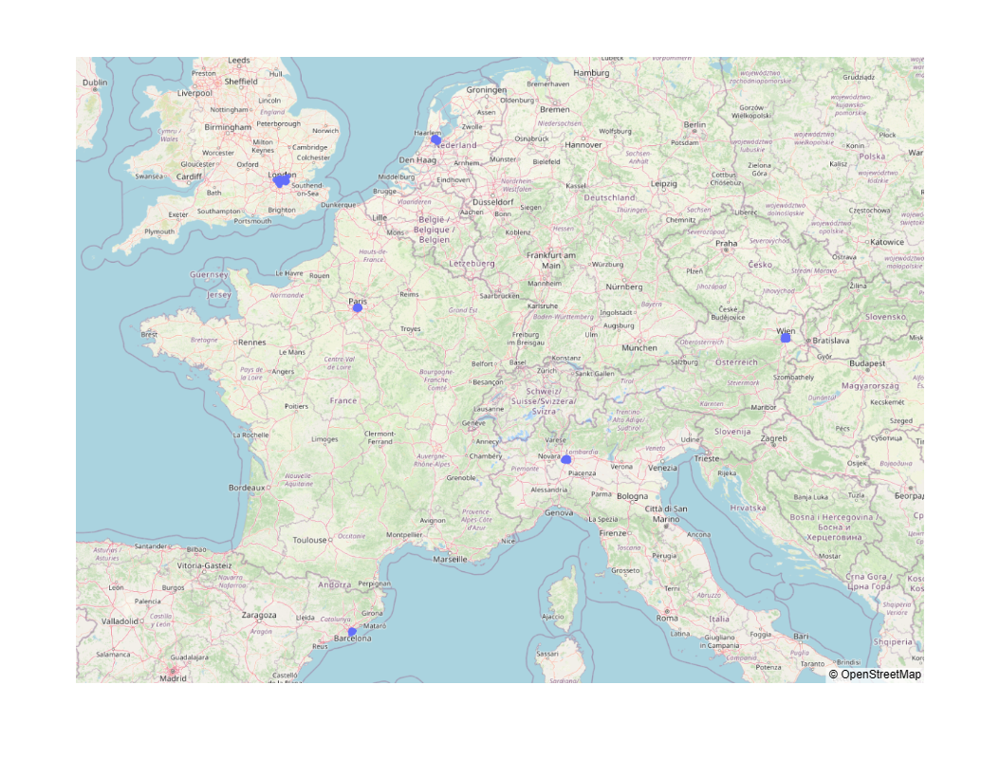

In [182]:
# Выберем информацию о отелях и визуализируем на карте мира 
hotels = data.drop_duplicates(subset = ['hotel_address','hotel_name','lat','lng'])

fig = px.scatter_mapbox(hotels.reset_index().reset_index(), lat="lat", lon="lng", 
                        #hover_name='neighborhood', 
                        #hover_data=['neighborhood','suburb','post_index'],
                        zoom=4.5,
                        height=800,
                        width=1000,
                        center={'lat':47.5,'lon':7},
                        opacity=0.9,
                        )


fig.update_layout(mapbox_style="open-street-map",
                  showlegend = False)


fig.show()

В нашем датасете, из адреса можно выделить Город и Страну, что в совокупности с расстоянием до центра города, должно дать нашей моделе более сильный набор признаков, чем адрес.
Выше мы смотрели на формат адреса, и помним, что в случае города Великобританию следует обрабатывать отличным от остальных образом.


In [183]:
# Выделим страну из адресной строки
data['country'] = data.apply(
    lambda x : 'United Kingdom' if x.hotel_address.split()[-1] == 'Kingdom' else x.hotel_address.split()[-1],
    axis = 1)
countries = data.country.unique()
print(countries)

['United Kingdom' 'France' 'Netherlands' 'Italy' 'Austria' 'Spain']


Страны успешно выделены и их всего 6, приступим к выделению города.

In [184]:
data['city'] = data.apply(                  
                        lambda x: x['hotel_address'].split()[-2] 
                        if x['country'] != 'United Kingdom'
                        else x['hotel_address'].split()[-5], axis=1)
cities = data.city.unique()
print(cities)

['London' 'Paris' 'Amsterdam' 'Milan' 'Vienna' 'Barcelona']


И городов тоже 6, проверим, что 1 город строго из 1 страны (хотя это было видно на нашей карте выше):

In [185]:
data.groupby(by=['country','city'])['hotel_name'].count()

country         city     
Austria         Vienna        38938
France          Paris         59626
Italy           Milan         37206
Netherlands     Amsterdam     57212
Spain           Barcelona     60149
United Kingdom  London       262300
Name: hotel_name, dtype: int64

Да, у нас всего 6 вариантов страна-город, можно оставить только один из двух признаков. А теперь с помощью визуализации подтвердим нашу гипотезу, о наличие зависимости между городом(страной) и средним рейтингом отеля.

In [187]:
# сводная таблица городов и средних оценок в них
piv_city = pd.pivot_table(
                    data[data['sample']==1],
                    index='city',
                    values='reviewer_score',
                    aggfunc='mean',
                    )
piv_city

,reviewer_score
city,
Amsterdam,8.449142
Barcelona,8.553747
London,8.326877
Milan,8.355541
Paris,8.424248
Vienna,8.552593


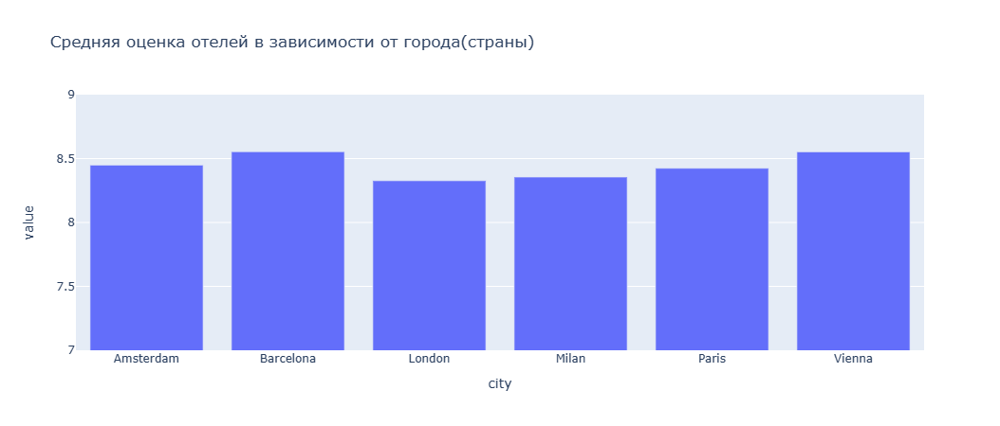

In [188]:
# Визуализируем зависимость средней оценки от города
fig = px.bar(
    data_frame=piv_city,
    title='Средняя оценка отелей в зависимости от города(страны)',
    width=800,
)
fig.update_layout(showlegend = False)
fig.update_yaxes(range=[7, 9]) 
fig.show()

По графику видно, что хоть и небольшая, но есть разница между средними оценками в разных городах + набор данных был достаточно большой, поэтому вероятность, что разница получена из-за случайного разброса уменьшается - хотя лучше бы перепроверить это с помощью статистического теста.

Давайте все таки проведем статистический тест, и проверим гипотезу, о том, что, например, в Барселоне средняя оценка отелей выше чем в Лондоне (Города возьмем из нашего графика как город с максимальным и минимальным средним рейтингом).

Для начала хорошо бы посмотреть на распределение нашего таргета - среднего рейтинга.

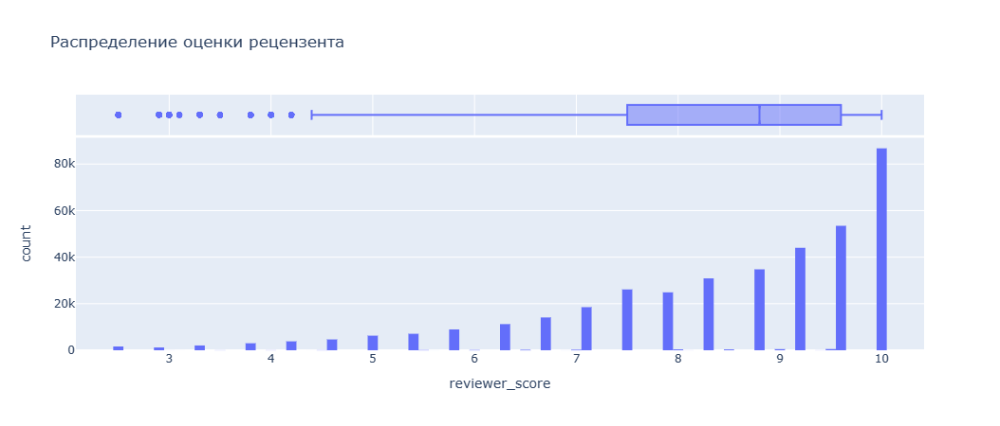

In [189]:
fig = px.histogram(
    data_frame=data[data['sample']==1],
    x='reviewer_score',
    title='Распределение оценки рецензента',
    marginal='box',
    width=800,
)
fig.show()

Распределение признака точно не похоже на нормальное, используем U-критерий Манна - Уитни. 

Так же раз уже построили распределение таргета, посмотрим на него. Видим, что большая часть значений рейтинга лежит в интервале 4.4-10. Аномальных значений нет. Потенциальные выбросы со значением меньше 4.4 не кажутся экстремально отличающимися, по опыту прошлого соревнования с продажей Б/У авто иногда лучше не удалять такие значения, так как это сужает диапазон предсказаний модели, позже проверим это на практике.

In [190]:

# Постановка гипотез
H0 = 'Средний рейтинг в  Барселоне и Лондоне одинаковый'

H1 = 'Средний рейтинг в Лондоне меньше, чем в Барселоне'

# уровень значимости
alpha = 0.1

_, p = mannwhitneyu(
    x = data[(data['sample']==1) & (data['city']=='London')]['reviewer_score'],
    y = data[(data['sample']==1) & (data['city']=='Barcelona')]['reviewer_score'],
    alternative='less'
    )

if p < alpha:
    print(f'p={p:.4f} - принимаем альтернативную гипотезу - '+H1)
else:
    print(f'p={p:.4f} - принимаем нулевую гипотезу - '+H0)

p=0.0000 - принимаем альтернативную гипотезу - Средний рейтинг в Лондоне меньше, чем в Барселоне


Тест проведен - разница между средней оценкой в городах есть, поэтому признак города оставляем.

Сразу закодируем город через OneHotEncoding.

In [191]:
encoder = ce.OneHotEncoder(cols=['city']) # указываем столбец для кодирования
type_bin = encoder.fit_transform(data['city'])
type_bin = type_bin.rename(columns={'city_1':'London','city_2':'Paris','city_3':'Amsterdam','city_4':'Milan','city_5':'Vienna','city_6':'Barcelona'})
data = pd.concat([data, type_bin], axis=1)
data.head(3)


,hotel_address,additional_number_of_scoring,review_date,average_score,hotel_name,reviewer_nationality,negative_review,review_total_negative_word_counts,total_number_of_reviews,positive_review,...,lng,sample,country,city,London,Paris,Amsterdam,Milan,Vienna,Barcelona
0,Stratton Street Mayfair Westminster Borough London W1J 8LT United Kingdom,581,2/19/2016,8.4,The May Fair Hotel,United Kingdom,Leaving,3,1994,Staff were amazing,...,-0.143671,1,United Kingdom,London,1,0,0,0,0,0
1,130 134 Southampton Row Camden London WC1B 5AF United Kingdom,299,1/12/2017,8.3,Mercure London Bloomsbury Hotel,United Kingdom,poor breakfast,3,1361,location,...,-0.123097,1,United Kingdom,London,1,0,0,0,0,0
2,151 bis Rue de Rennes 6th arr 75006 Paris France,32,10/18/2016,8.9,Legend Saint Germain by Elegancia,China,No kettle in room,6,406,No Positive,...,2.325643,1,France,Paris,0,1,0,0,0,0


### Расстояние до центра города.

Теперь, создадим признак расстояние до центра города, для этого сначала составим справочную таблицу для координат городов.

In [192]:
centers = [] # список координат центров городов
for city in cities:
    location = geolocator.geocode(city)
    centers.append([city, location.longitude, location.latitude])

city_centers = pd.DataFrame(data = centers, columns = ['city','center_lng', 'center_lat'])
city_centers

,city,center_lng,center_lat
0,London,-0.127650,51.507336
1,Paris,2.348391,48.853495
2,Amsterdam,4.892453,52.373080
3,Milan,9.189635,45.464194
4,Vienna,16.372504,48.208354
5,Barcelona,2.177432,41.382894


In [193]:
data = data.merge(city_centers, how='left', on='city')
data.head()

,hotel_address,additional_number_of_scoring,review_date,average_score,hotel_name,reviewer_nationality,negative_review,review_total_negative_word_counts,total_number_of_reviews,positive_review,...,country,city,London,Paris,Amsterdam,Milan,Vienna,Barcelona,center_lng,center_lat
0,Stratton Street Mayfair Westminster Borough London W1J 8LT United Kingdom,581,2/19/2016,8.4,The May Fair Hotel,United Kingdom,Leaving,3,1994,Staff were amazing,...,United Kingdom,London,1,0,0,0,0,0,-0.127650,51.507336
1,130 134 Southampton Row Camden London WC1B 5AF United Kingdom,299,1/12/2017,8.3,Mercure London Bloomsbury Hotel,United Kingdom,poor breakfast,3,1361,location,...,United Kingdom,London,1,0,0,0,0,0,-0.127650,51.507336
2,151 bis Rue de Rennes 6th arr 75006 Paris France,32,10/18/2016,8.9,Legend Saint Germain by Elegancia,China,No kettle in room,6,406,No Positive,...,France,Paris,0,1,0,0,0,0,2.348391,48.853495
3,216 Avenue Jean Jaures 19th arr 75019 Paris France,34,9/22/2015,7.5,Mercure Paris 19 Philharmonie La Villette,United Kingdom,No Negative,0,607,Friendly staff quiet comfortable room spotlessly clean excellent location,...,France,Paris,0,1,0,0,0,0,2.348391,48.853495
4,Molenwerf 1 1014 AG Amsterdam Netherlands,914,3/5/2016,8.5,Golden Tulip Amsterdam West,Poland,Torn sheets,4,7586,The staff was very friendly and helpful Breakfasts were just extraordinary Room was clean quiet and very spacious,...,Netherlands,Amsterdam,0,0,1,0,0,0,4.892453,52.373080


Теперь можем рассчитать расстояние от отеля до центра города. (Хочется отметить, что под центром города мы получаем координаты "нулевого километра" (обычно это ближайший перекрёсток от главпочтамта), с учетом, что у нас отзывы людей как по туристическим поездкам, так и по рабочим, нас данный вариант устроит, но если бы мы рассматривали только туристические поездки, можно, например, было бы рассчитывать расстояние не до центра города, а до главных достопримечательностей и т.д.)

In [194]:
%%time

data['distance_city_center'] = data.apply(
                                lambda x :geodesic((x.lat,x.lng),(x.center_lat, x.center_lng)).kilometers,
                                axis = 1)
data.head(2)

CPU times: user 2min 39s, sys: 624 ms, total: 2min 39s
Wall time: 2min 39s


,hotel_address,additional_number_of_scoring,review_date,average_score,hotel_name,reviewer_nationality,negative_review,review_total_negative_word_counts,total_number_of_reviews,positive_review,...,city,London,Paris,Amsterdam,Milan,Vienna,Barcelona,center_lng,center_lat,distance_city_center
0,Stratton Street Mayfair Westminster Borough London W1J 8LT United Kingdom,581,2/19/2016,8.4,The May Fair Hotel,United Kingdom,Leaving,3,1994,Staff were amazing,...,London,1,0,0,0,0,0,-0.12765,51.507336,1.114034
1,130 134 Southampton Row Camden London WC1B 5AF United Kingdom,299,1/12/2017,8.3,Mercure London Bloomsbury Hotel,United Kingdom,poor breakfast,3,1361,location,...,London,1,0,0,0,0,0,-0.12765,51.507336,1.553681


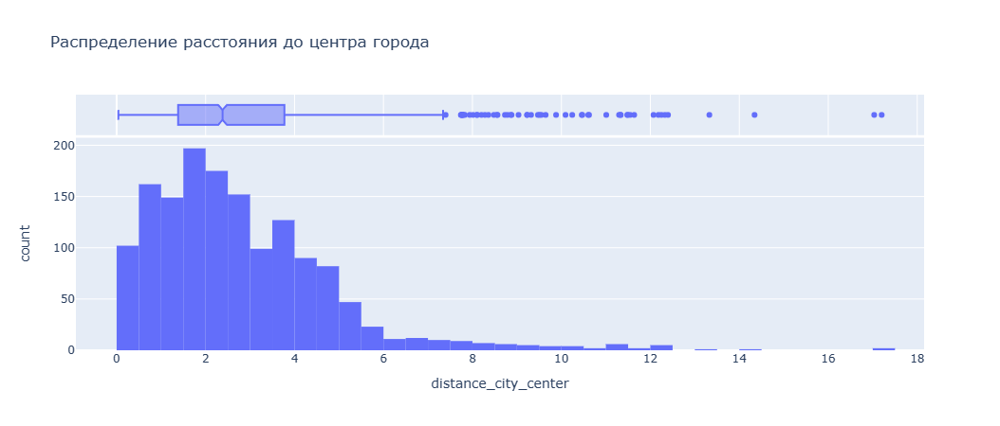

In [195]:
# построим гистограмму распределения расстояния до центра города
fig = px.histogram(
    data_frame=data.groupby('hotel_name', as_index=False).distance_city_center.min(),
    x='distance_city_center',
    title='Распределение расстояния до центра города',
    nbins=70,
    marginal='box',
    width=800,
)
fig.show()

Распределение напоминает лог-нормальное, большая часть значений лежит в диапазоне от 0 до 3,8 км, есть некоторое количество выбросов, однако признать эти значения аномальными нельзя, так как они вполне адекватны.

Посмотрим теперь зависимость созданного признака и целевого.

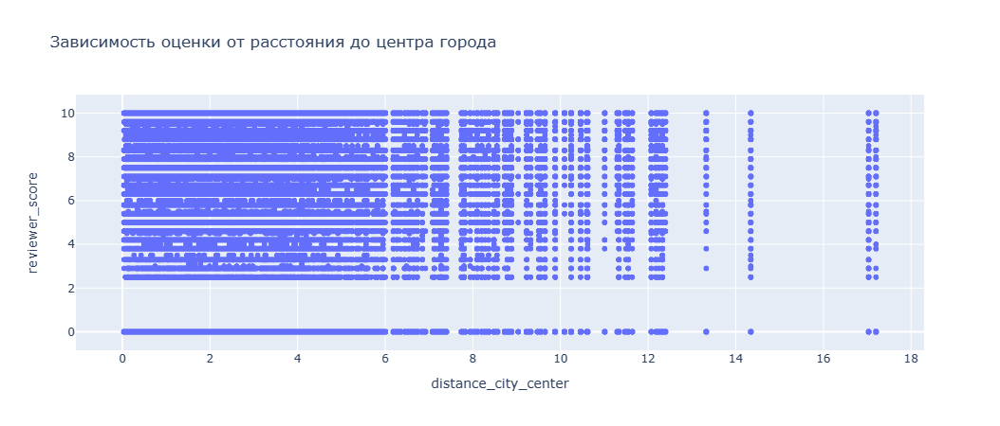

In [196]:
fig = px.scatter(
                data,
                x='distance_city_center',
                y='reviewer_score',
                title='Зависимость оценки от расстояния до центра города',
                width=800,
                )
fig.show()

По графику видно отсутствие зависимости рейтинга отелея от расстояния от центра.

На всякий случай, проверим себя с помощью корреляции Спирмана, так как признаки распределены ненормально.

In [197]:
corr, p = spearmanr(data[(data['sample']==1)]['distance_city_center'], data[(data['sample']==1)]['reviewer_score'])

print(corr, p)
if p > alpha:
    print(f'{p} > {alpha}. Мы не можем отвергнуть нулевую гипотизу: об отсутствии зависимости между переменными.')
else:
    print(f'{p} <= {alpha}. Мы отвергаем нулевую гипотизу об отсутствие зависимости между переменными')



-0.09959666749956093 0.0
0.0 <= 0.1. Мы отвергаем нулевую гипотизу об отсутствие зависимости между переменными


Хоть и небольшая, но корреляция присутствует, поэтому оставим и признак расстояния до центра.

Давайте ради интереса в конце работы с признаками расположения отеля, построим тепловую карту зависимости рейтинга от расстояния до центра в разрезе города и заодно округлим значение расстояние до точности 100м - 1 знак после запятой (уменьшает количество уникальных значений, и как показала практика немного улучшает метрику).

In [198]:
data['distance_city_center'] = data['distance_city_center'].round(1)
data['distance_city_center'].unique()


array([ 1.1,  1.6,  1.9,  5.2,  3.4,  5.6,  4.2,  1.4,  3.7,  5.9,  4.8,
        3.9,  1.5,  2.3,  4.6,  0.6,  8.1,  9.2,  1. ,  2.9,  0.7,  4.3,
        2.8,  5.7,  8.5,  3.6,  0.4,  7.3,  4.1,  2. ,  1.2,  1.3,  0.2,
        7.7,  2.7,  8.2,  3.5, 13.3,  4.7,  2.4,  3.2,  0.3,  6.6,  6.8,
        2.5,  0.8,  5.3,  0.5, 12.3,  1.8,  2.2,  0.9,  5.1,  8.6,  3.8,
        4. , 12.2, 11.3,  7.8, 11.6,  3.3,  4.9,  4.5,  3.1,  6.4,  8.4,
        5.4,  3. ,  5. ,  2.6, 10.6,  9.9,  9.6,  1.7, 10.5,  2.1,  6.5,
        0.1,  5.8,  5.5,  6.7,  6.3,  8.9,  7.4,  4.4, 14.3,  7.9,  7.2,
        9.5, 11.5,  6.2, 12.1,  6.9, 10.2,  9.3,  7.1, 17. , 11. ,  8.7,
        8.8, 10.1, 12.4,  8. , 17.2,  8.3,  6. ,  0. ,  9. ])

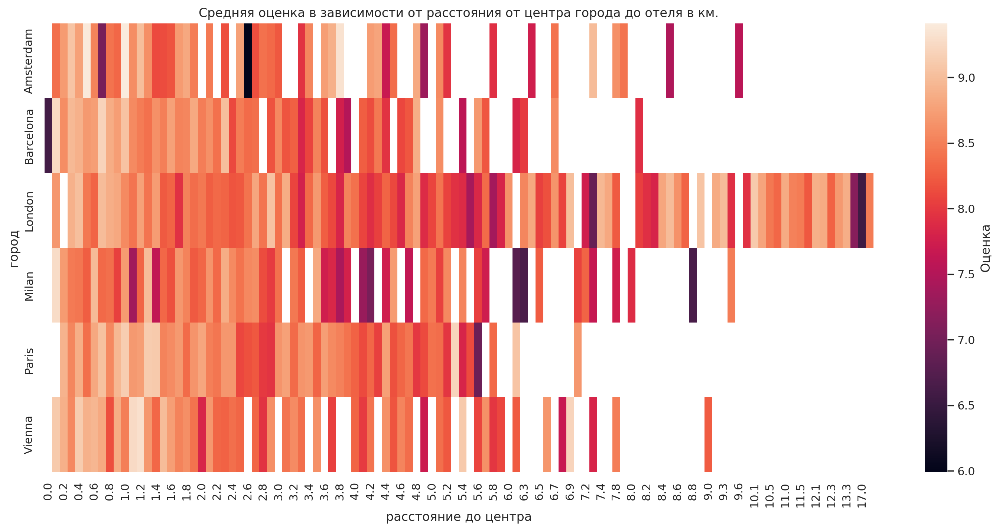

In [199]:
pivot_distance = data[data['sample']==1].pivot_table(
    values='reviewer_score',
    columns='distance_city_center',
    index='city',
    )

fig, ax = plt.subplots(figsize=(18,8))    
heatmap = sns.heatmap(data=pivot_distance, cbar_kws={'label': 'Оценка'})
heatmap.set_title('Средняя оценка в зависимости от расстояния от центра города до отеля в км.');
heatmap.set_xlabel('расстояние до центра');
heatmap.set_ylabel('город');

Хоть карта и неоднородная, но на первый взгляд в некоторых городах, например Вена или Париж, прослеживается, что с увеличением расстояния от центра, оценка становится несколько ниже. Плюс по данному графику можно косвенно наблюдать размер городов, по числу отелей сильно отдаленных от центра (видно, к  примеру, что Лондон самый большой). 

Полученные метрики на данном этапе:
- без расстояния до центра - 14.1237,
- с расстоянием до центра -  14.1215,
- с закодированным признаком города - 14.1134
- с округлением расстояния до центра - 14.1049

На самом деле обработав адрес, получив из него город и расстояние от отеля до центра города, применив кодирование мы получили улучшение метрики на 0.02%, то есть на данном этапе можно сказать, что признаки связанные с адресом практически не повлияли на точность модели, но лучше 0.02% чем ничего).

## Даты: дата отзыва 'review_date' и количество дней с отзыва 'days_since_review'.

Сразу в глаза бросается, что 'days_since_review' зачем-то имеет текстовый формат с допиской слова 'days' - преобразуем признак к числовому.

In [200]:
data['days_since_review'] = data['days_since_review'].apply(lambda x: int(x.split(' ')[0]))
data['days_since_review'].describe()

count    515431.000000
mean        354.405492
std         208.915335
min           0.000000
25%         175.000000
50%         353.000000
75%         527.000000
max         730.000000
Name: days_since_review, dtype: float64

У меня было предположение, о преобразование признака из числа дней в число месяцев, что уменьшает диапазон значений, однако это изменило метрику почти на 0.1 % в худшую сторону.

Выделим из даты отзыва дополнительные признаки. Попробуем посмотреть к примеру зависимость рейтинга в оценке от дня недели, и месяца. Сразу стоит отметить, у меня было предположении, что возможно лучше брать не месяц года, а связку год-месяц, но проверка показала, что зависимость именно сезонная и особое влияния года отсутствует, поэтому работаем с месяцем и днем недели.

In [201]:
data['review_month'] = pd.to_datetime(data['review_date']).dt.month
data['review_week_day'] = pd.to_datetime(data['review_date']).dt.day_of_week

Теперь закодируем эти признаки с помощью One Hot Encoder

In [202]:
# кодируем месяц
encoder = ce.OneHotEncoder(cols=['review_month'])
type_bin = encoder.fit_transform(data['review_month'])
data = pd.concat([data, type_bin], axis=1)

# кодируем день недели
encoder = ce.OneHotEncoder(cols=['review_week_day'])
type_bin = encoder.fit_transform(data['review_week_day'])
data = pd.concat([data, type_bin], axis=1)


Посмотрим на зависимость средней оценки (таргета) от месяца и дня недели.

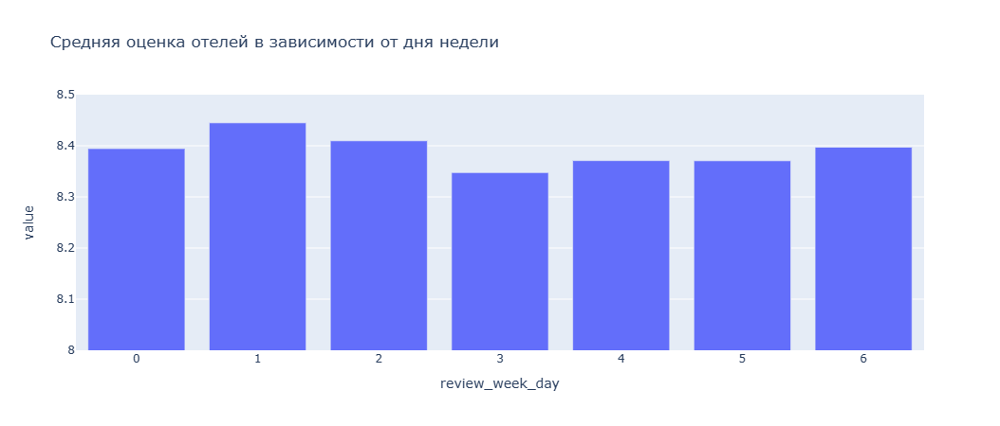

In [203]:
# сводная таблица дней недели и средних оценок в них
piv_weekday = pd.pivot_table(
                    data[data['sample']==1],
                    index='review_week_day',
                    values='reviewer_score',
                    aggfunc='mean',
                    )
piv_weekday

# Визуализируем зависимость средней оценки 
fig = px.bar(
    data_frame=piv_weekday,
    title='Средняя оценка отелей в зависимости от дня недели',
    width=800,
)
fig.update_layout(showlegend = False)
fig.update_yaxes(range=[8, 8.5]) 
fig.show()

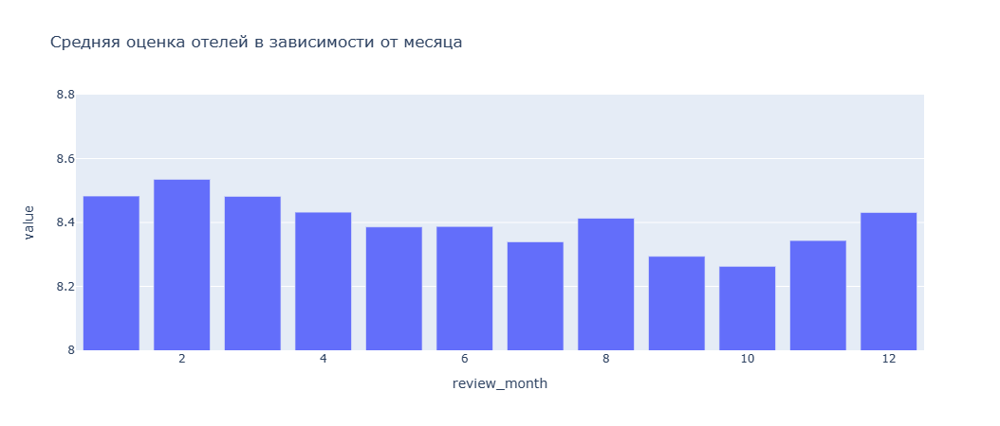

In [204]:
# сводная таблица месяцев и средних оценок в них
piv_month = pd.pivot_table(
                    data[data['sample']==1],
                    index='review_month',
                    values='reviewer_score',
                    aggfunc='mean',
                    )
piv_month

# Визуализируем зависимость средней оценки 
fig = px.bar(
    data_frame=piv_month,
    title='Средняя оценка отелей в зависимости от месяца',
    width=800,
)
fig.update_layout(showlegend = False)
fig.update_yaxes(range=[8, 8.8]) 
fig.show()

По построенным диаграммам видно, что самые низкие оценки в октябре, самые высокие в феврале. При анализе дня недели самые низкие оценки по четвергам, а самые высокие во вторники.

Разброс оценок по дням недели меньше чем по месяцам, но он есть в обоих случаях.

In [205]:
data_copy = data.copy()
data_copy.head(2)

,hotel_address,additional_number_of_scoring,review_date,average_score,hotel_name,reviewer_nationality,negative_review,review_total_negative_word_counts,total_number_of_reviews,positive_review,...,review_month_10,review_month_11,review_month_12,review_week_day_1,review_week_day_2,review_week_day_3,review_week_day_4,review_week_day_5,review_week_day_6,review_week_day_7
0,Stratton Street Mayfair Westminster Borough London W1J 8LT United Kingdom,581,2/19/2016,8.4,The May Fair Hotel,United Kingdom,Leaving,3,1994,Staff were amazing,...,0,0,0,1,0,0,0,0,0,0
1,130 134 Southampton Row Camden London WC1B 5AF United Kingdom,299,1/12/2017,8.3,Mercure London Bloomsbury Hotel,United Kingdom,poor breakfast,3,1361,location,...,0,0,0,0,1,0,0,0,0,0


In [206]:
data = data_copy.copy()

## Национальность рецензента

In [207]:
data['reviewer_nationality'].describe()

count               515431
unique                 227
top        United Kingdom 
freq                245165
Name: reviewer_nationality, dtype: object

227 уникальных значений, достаточно много, посмотрим распределение по странам:

In [208]:
data['reviewer_nationality'].value_counts()

 United Kingdom               245165
 United States of America      35390
 Australia                     21663
 Ireland                       14820
 United Arab Emirates          10230
                               ...  
 Guinea                            1
 Tuvalu                            1
 Comoros                           1
 Anguilla                          1
 Cape Verde                        1
Name: reviewer_nationality, Length: 227, dtype: int64

Почти половина значений это Великобритания, а в конце много стран с маленьким числом отзывов, оставим страны, где отзывов больше 100, остальные заменим  на "other" (также по отчету было видно наличие пустых строк в данном признаке  523 значения(не none) они также будут заменены на "other"). 

In [209]:
data['reviewer_nationality'].value_counts().head(105)

 United Kingdom               245165
 United States of America      35390
 Australia                     21663
 Ireland                       14820
 United Arab Emirates          10230
                               ...  
 Bermuda                         103
 Brunei                          100
 Algeria                         100
 Uruguay                          91
 Venezuela                        78
Name: reviewer_nationality, Length: 105, dtype: int64

На всякий случай удалим лишнии пробелы

In [210]:
data['reviewer_nationality'] = data['reviewer_nationality'].apply(lambda x: x.strip())

Визуализируем зависимость таргета от данного признака.

In [211]:
nations = list(data['reviewer_nationality'].value_counts().nlargest(103).index)

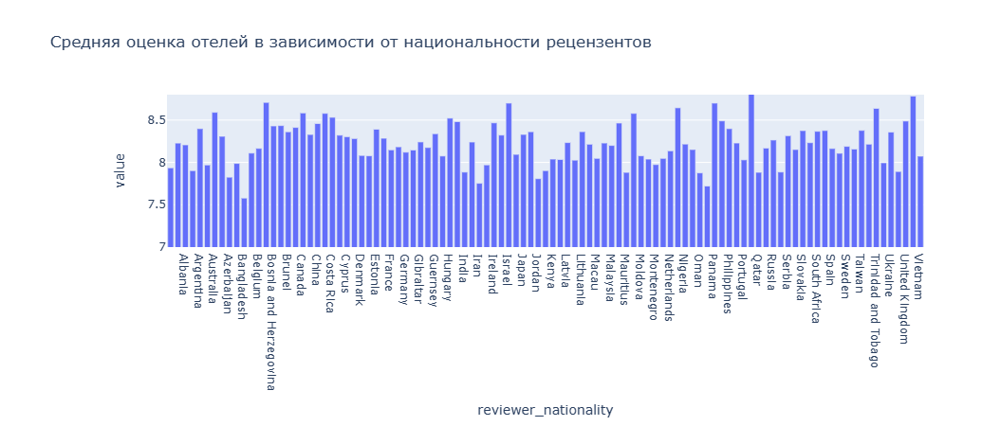

In [212]:
# сводная таблица национальностей рецензентов и средних оценок в них
piv_nation = pd.pivot_table(
                    data[(data['sample']==1) & (data['reviewer_nationality'].isin(nations))],
                    index='reviewer_nationality',
                    values='reviewer_score',
                    aggfunc='mean',
                    )
piv_nation

# Визуализируем зависимость средней оценки 
fig = px.bar(
    data_frame=piv_nation,
    title='Средняя оценка отелей в зависимости от национальности рецензентов',
    width=800,
)
fig.update_layout(showlegend = False)
fig.update_yaxes(range=[7, 8.8]) 
fig.show()

По диаграмме видно, что зависимость от страны, хоть и небольшая но есть, также если посмотреть на страны в одном регионе, то видно, что возможно будет более сильная зависимость именно от региона или подрегиона, а не от конкретной страны.

In [213]:
data['reviewer_nationality'] = data['reviewer_nationality'].apply(lambda x: 'Other' if (x not in nations) or (x == '') else x)

bin_encoder = ce.BinaryEncoder(cols=['reviewer_nationality']) 
type_bin = bin_encoder.fit_transform(data['reviewer_nationality'])
data = pd.concat([data, type_bin], axis=1)

### Подрегионы и регионы

In [214]:
data['reviewer_nationality'].value_counts()

United Kingdom              245165
United States of America     35390
Australia                    21663
Ireland                      14820
United Arab Emirates         10230
                             ...  
Macau                          109
Moldova                        108
Bermuda                        103
Brunei                         100
Algeria                        100
Name: reviewer_nationality, Length: 103, dtype: int64

Попробуем создать новый признак региона и подрегиона.

На kaggle удалось найти файл с странами и регионами, загрузим его.

In [215]:
data_copy = data.copy()

In [216]:
country_reg = pd.read_csv('/kaggle/input/dataset/datasets/Other/country_regions.csv')
# Оставим только нужные нам поля
country_reg = country_reg[['name', 'region','sub-region']]
country_reg

,name,region,sub-region
0,Afghanistan,Asia,Southern Asia
1,Åland Islands,Europe,Northern Europe
2,Albania,Europe,Southern Europe
3,Algeria,Africa,Northern Africa
4,American Samoa,Oceania,Polynesia
...,...,...,...
244,Wallis and Futuna,Oceania,Polynesia
245,Western Sahara,Africa,Northern Africa
246,Yemen,Asia,Western Asia
247,Zambia,Africa,Sub-Saharan Africa


In [217]:
data = data.merge(
                country_reg,
                how='left',
                left_on='reviewer_nationality',
                right_on='name',
                suffixes = ("", "")
                )
data.head()

,hotel_address,additional_number_of_scoring,review_date,average_score,hotel_name,reviewer_nationality,negative_review,review_total_negative_word_counts,total_number_of_reviews,positive_review,...,reviewer_nationality_0,reviewer_nationality_1,reviewer_nationality_2,reviewer_nationality_3,reviewer_nationality_4,reviewer_nationality_5,reviewer_nationality_6,name,region,sub-region
0,Stratton Street Mayfair Westminster Borough London W1J 8LT United Kingdom,581,2/19/2016,8.4,The May Fair Hotel,United Kingdom,Leaving,3,1994,Staff were amazing,...,0,0,0,0,0,0,1,NaN,NaN,NaN
1,130 134 Southampton Row Camden London WC1B 5AF United Kingdom,299,1/12/2017,8.3,Mercure London Bloomsbury Hotel,United Kingdom,poor breakfast,3,1361,location,...,0,0,0,0,0,0,1,NaN,NaN,NaN
2,151 bis Rue de Rennes 6th arr 75006 Paris France,32,10/18/2016,8.9,Legend Saint Germain by Elegancia,China,No kettle in room,6,406,No Positive,...,0,0,0,0,0,1,0,China,Asia,Eastern Asia
3,216 Avenue Jean Jaures 19th arr 75019 Paris France,34,9/22/2015,7.5,Mercure Paris 19 Philharmonie La Villette,United Kingdom,No Negative,0,607,Friendly staff quiet comfortable room spotlessly clean excellent location,...,0,0,0,0,0,0,1,NaN,NaN,NaN
4,Molenwerf 1 1014 AG Amsterdam Netherlands,914,3/5/2016,8.5,Golden Tulip Amsterdam West,Poland,Torn sheets,4,7586,The staff was very friendly and helpful Breakfasts were just extraordinary Room was clean quiet and very spacious,...,0,0,0,0,0,1,1,Poland,Europe,Eastern Europe


Не все регионы подтянулись, посмотрим каких не хватает.

In [218]:
data[pd.isna(data['region'])]['reviewer_nationality'].value_counts()

United Kingdom      245165
Russia                3898
Other                 2898
Czech Republic        2311
Iran                  1085
South Korea           1075
Taiwan                 923
Macedonia              282
Vietnam                187
Abkhazia Georgia       153
Macau                  109
Moldova                108
Brunei                 100
Name: reviewer_nationality, dtype: int64

Стран не много, заполним руками.

In [219]:
europe = ['United Kingdom','Russia','Czech Republic', 'Macedonia', 'Moldova']
asia = ['Iran', 'Taiwan', 'Vietnam', 'Macau', 'Brunei', 'South Korea', 'Abkhazia Georgia' ]
data.loc[data['reviewer_nationality'].isin(europe), 'region']= 'Europe'
data.loc[data['reviewer_nationality'].isin(asia), 'region']= 'Asia'
data.loc[data['reviewer_nationality'] == 'Other', 'region']= 'Other'
data[pd.isna(data['region'])]['reviewer_nationality'].value_counts()

Series([], Name: reviewer_nationality, dtype: int64)

Теперь подрегионы.

In [220]:
Eastern_Europe = ['Russia', 'Czech Republic','Moldova']
Southern_Europe = ['Macedonia']
Northern_Europe = ['United Kingdom']  
Western_Asia = ['Abkhazia Georgia', 'Iran']
Eastern_Asia = ['Taiwan', 'South Korea', 'Macau']
South_eastern_Asia = ['Vietnam', 'Brunei']
data.loc[data['reviewer_nationality'].isin(Eastern_Europe), 'sub-region']= 'Eastern_Europe'
data.loc[data['reviewer_nationality'].isin(Southern_Europe), 'sub-region']= 'Southern Europe'
data.loc[data['reviewer_nationality'].isin(Northern_Europe), 'sub-region']= 'Northern Europe'
data.loc[data['reviewer_nationality'].isin(Western_Asia), 'sub-region']= 'Western Asia'
data.loc[data['reviewer_nationality'].isin(Eastern_Asia), 'sub-region']= 'Eastern Asia'
data.loc[data['reviewer_nationality'].isin(South_eastern_Asia), 'sub-region']= 'South-eastern Asia'

data.loc[data['reviewer_nationality'] == 'Other', 'sub-region']= 'Other'
data[pd.isna(data['region'])]['reviewer_nationality'].value_counts()

Series([], Name: reviewer_nationality, dtype: int64)

Отлично, пропусков не осталось, посмотрим зависимость таргета от региона.

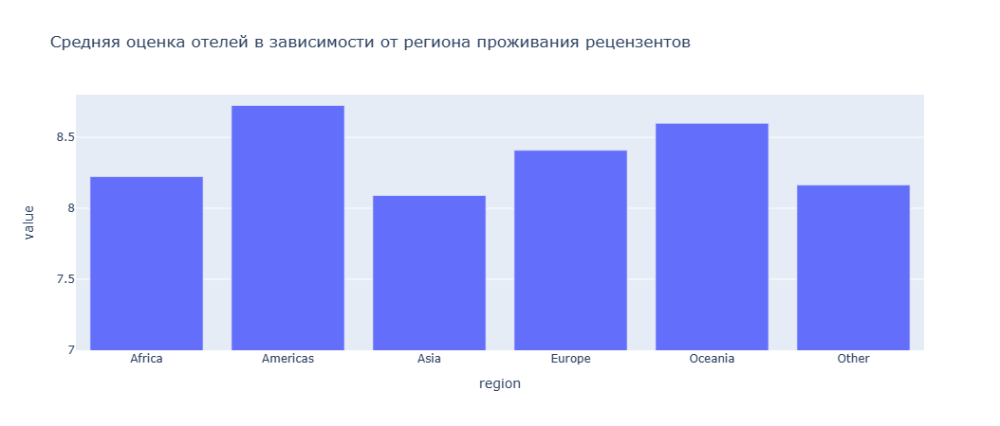

In [221]:
# сводная таблица регионов рецензентов и средних оценок в них
piv_nation = pd.pivot_table(
                    data[data['sample']==1],
                    index='region',
                    values='reviewer_score',
                    aggfunc='mean',
                    )
piv_nation

# Визуализируем зависимость средней оценки 
fig = px.bar(
    data_frame=piv_nation,
    title='Средняя оценка отелей в зависимости от региона проживания рецензентов',
    width=800,
)
fig.update_layout(showlegend = False)
fig.update_yaxes(range=[7, 8.8]) 
fig.show()

теперь подрегионы

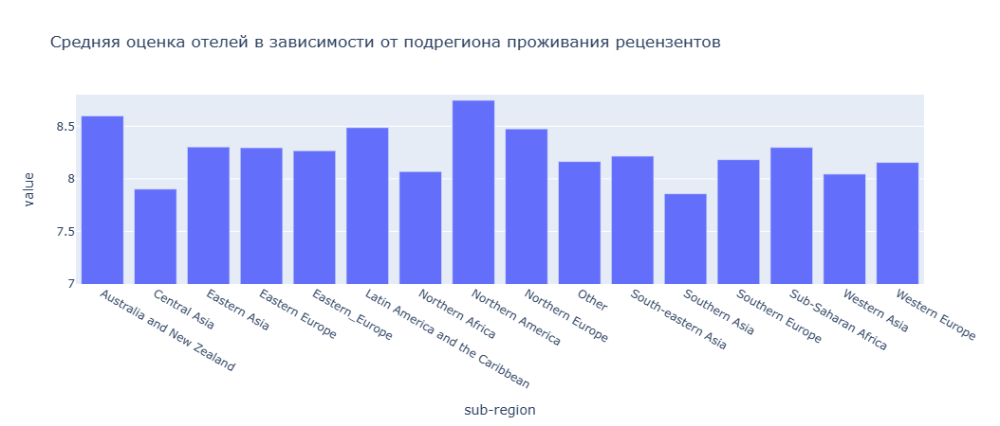

In [222]:
# сводная таблица подрегионов рецензентов и средних оценок в них
piv_nation = pd.pivot_table(
                    data[data['sample']==1],
                    index='sub-region',
                    values='reviewer_score',
                    aggfunc='mean',
                    )
piv_nation

# Визуализируем зависимость средней оценки 
fig = px.bar(
    data_frame=piv_nation,
    title='Средняя оценка отелей в зависимости от подрегиона проживания рецензентов',
    width=800,
)
fig.update_layout(showlegend = False)
fig.update_yaxes(range=[7, 8.8]) 
fig.show()

С виду достаточно сильная зависимость, закодируем новые признаки.

In [223]:
ohe_encoder = ce.OneHotEncoder(cols=['region']) 
type_bin = ohe_encoder.fit_transform(data['region'])
data = pd.concat([data, type_bin], axis=1)

ohe_encoder = ce.OneHotEncoder(cols=['sub-region']) 
type_bin = ohe_encoder.fit_transform(data['sub-region'])
data = pd.concat([data, type_bin], axis=1)

Действительно, лучшая метрика получается, при одновременном использовании региона, подрегиона и страны рецензента.

In [224]:
data_copy3 = data.copy()
data_copy3.head(2)

,hotel_address,additional_number_of_scoring,review_date,average_score,hotel_name,reviewer_nationality,negative_review,review_total_negative_word_counts,total_number_of_reviews,positive_review,...,sub-region_7,sub-region_8,sub-region_9,sub-region_10,sub-region_11,sub-region_12,sub-region_13,sub-region_14,sub-region_15,sub-region_16
0,Stratton Street Mayfair Westminster Borough London W1J 8LT United Kingdom,581,2/19/2016,8.4,The May Fair Hotel,United Kingdom,Leaving,3,1994,Staff were amazing,...,0,0,0,0,0,0,0,0,0,0
1,130 134 Southampton Row Camden London WC1B 5AF United Kingdom,299,1/12/2017,8.3,Mercure London Bloomsbury Hotel,United Kingdom,poor breakfast,3,1361,location,...,0,0,0,0,0,0,0,0,0,0


In [225]:
data = data_copy3.copy()

## Анализ тегов (tags)

Посмотрим на структуру признака 'tags'

In [226]:
data['tags'].value_counts().head(50)

[' Leisure trip ', ' Couple ', ' Double Room ', ' Stayed 1 night ', ' Submitted from a mobile device ']                      5101
[' Leisure trip ', ' Couple ', ' Standard Double Room ', ' Stayed 1 night ', ' Submitted from a mobile device ']             4931
[' Leisure trip ', ' Couple ', ' Superior Double Room ', ' Stayed 1 night ', ' Submitted from a mobile device ']             4366
[' Leisure trip ', ' Couple ', ' Deluxe Double Room ', ' Stayed 1 night ', ' Submitted from a mobile device ']               3987
[' Leisure trip ', ' Couple ', ' Double Room ', ' Stayed 2 nights ', ' Submitted from a mobile device ']                     3291
[' Leisure trip ', ' Couple ', ' Superior Double Room ', ' Stayed 2 nights ', ' Submitted from a mobile device ']            3099
[' Leisure trip ', ' Couple ', ' Standard Double Room ', ' Stayed 2 nights ', ' Submitted from a mobile device ']            2947
[' Leisure trip ', ' Couple ', ' Double Room ', ' Stayed 1 night ']                       

Видим всего 6 категорий тегов:
- тип поездки (бизнес или отдых)
- состав отдыхающих/командированных
- тип комнаты
- время пребывания 
- был ли питомец
- и отправлено с мобильного устройства

Но в каждой записи могут быть не все поля, то есть структура не одинаковая, попробуем разделить данный признак на отдельные.

### Тип поездки

Тип поездки принимает 2 значения 'Business trip' и 'Leisure trip' - создадим бинарный признак 'Business_trip':

In [227]:
data['Business_trip'] = data['tags'].apply(lambda x: 1 if 'Business trip' in x else 0)
# Сразу будем удалять обработанные части тэга
data['tags'] = data['tags'].apply(lambda x: x.replace("' Business trip ',", '').replace("' Leisure trip ',", ''))
data['Business_trip'].describe()

count    515431.000000
mean          0.160805
std           0.367352
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           1.000000
Name: Business_trip, dtype: float64

16% это рабочие поездки, сразу посмотрим есть ли разница в таргете у этих групп

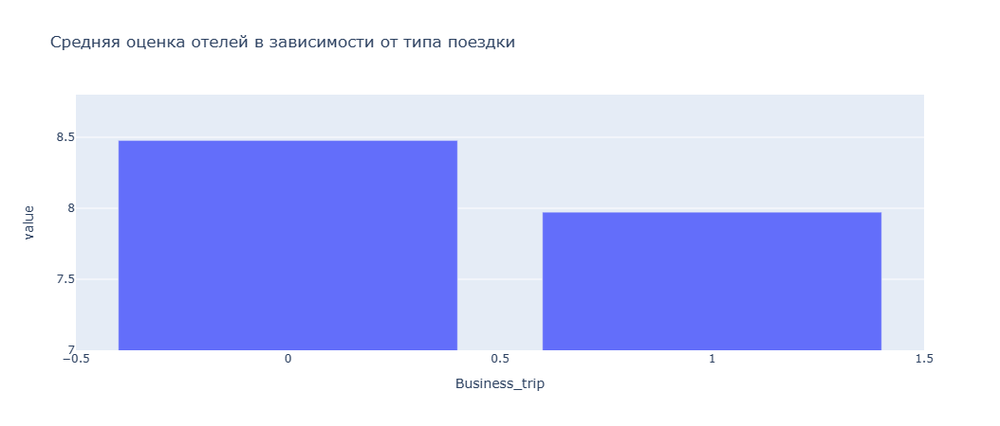

In [228]:
# сводная таблица типов поездки и средних оценок в них
piv_nation = pd.pivot_table(
                    data[data['sample']==1],
                    index='Business_trip',
                    values='reviewer_score',
                    aggfunc='mean',
                    )
piv_nation

# Визуализируем зависимость средней оценки 
fig = px.bar(
    data_frame=piv_nation,
    title='Средняя оценка отелей в зависимости от типа поездки',
    width=800,
)
fig.update_layout(showlegend = False)
fig.update_yaxes(range=[7, 8.8]) 
fig.show()

### Наличие питомцев

Поступаем аналогично с типом поездки

In [229]:
data['with_pet'] = data['tags'].apply(lambda x: 1 if 'With a pet' in x else 0)
data['tags'] = data['tags'].apply(lambda x: x.replace("' With a pet ',", ''))
data['with_pet'].describe()


count    515431.000000
mean          0.002726
std           0.052139
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           1.000000
Name: with_pet, dtype: float64

Людей с питомцами совсем мало, посмотрим на таргет в разрезе данного признака.

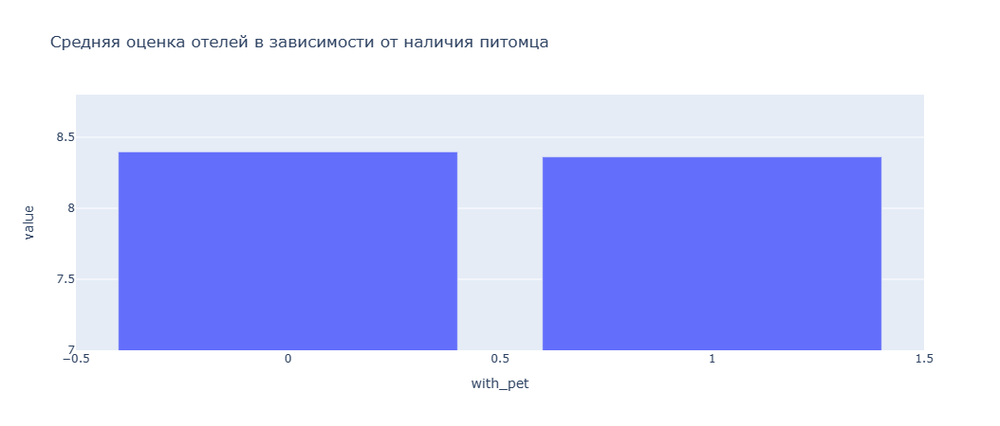

In [230]:
# сводная таблица наличия питомца и средних оценок в них
piv_nation = pd.pivot_table(
                    data[data['sample']==1],
                    index='with_pet',
                    values='reviewer_score',
                    aggfunc='mean',
                    )
piv_nation

# Визуализируем зависимость средней оценки 
fig = px.bar(
    data_frame=piv_nation,
    title='Средняя оценка отелей в зависимости от наличия питомца',
    width=800,
)
fig.update_layout(showlegend = False)
fig.update_yaxes(range=[7, 8.8]) 
fig.show()

Людей с питомцами меньше процента, взаимосвязь с оценкой практически отсутствует, возможно не будем в итоге использовать данный признак.

### Отправлено с мобильного устройства

Анологично поступаем с типом устройства

In [231]:
data['mobile'] = data['tags'].apply(lambda x: 1 if 'Submitted from a mobile device' in x else 0)
data['tags'] = data['tags'].apply(lambda x: x.replace("' Submitted from a mobile device '", ''))
data['mobile'].describe()

count    515431.000000
mean          0.596530
std           0.490594
min           0.000000
25%           0.000000
50%           1.000000
75%           1.000000
max           1.000000
Name: mobile, dtype: float64

Посмотрим есть ли зависимость с таргетом

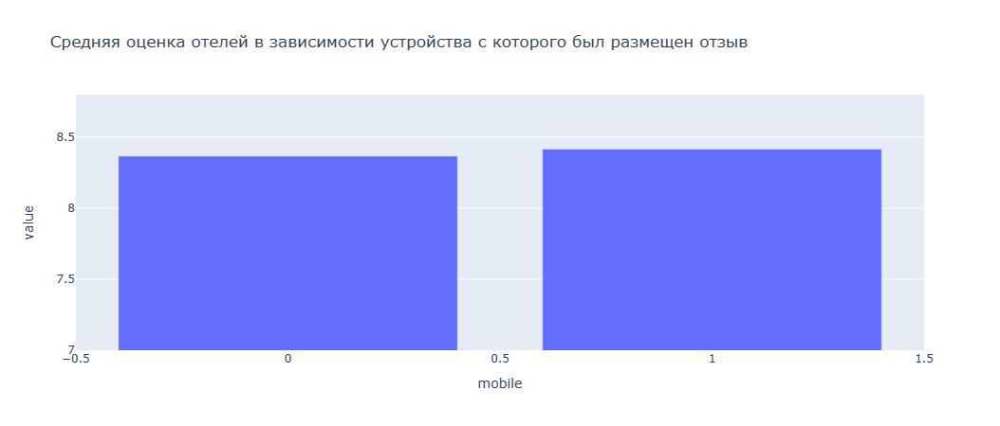

In [232]:
# сводная таблица  по типу устройства c которого был размещен отзыв
piv_nation = pd.pivot_table(
                    data[data['sample']==1],
                    index='mobile',
                    values='reviewer_score',
                    aggfunc='mean',
                    )
piv_nation

# Визуализируем зависимость средней оценки 
fig = px.bar(
    data_frame=piv_nation,
    title='Средняя оценка отелей в зависимости устройства c которого был размещен отзыв',
    width=800,
)
fig.update_layout(showlegend = False)
fig.update_yaxes(range=[7, 8.8]) 
fig.show()

Хоть зависимость не очень сильная, но она есть, и дает улучшение метрики.

### Количество ночей

Данная часть тега всегда выглядит как: ' Stayed {x} nights ' поэтому используем регулярные выражения и создадим числовой признак. 

In [233]:
reg_stay = "\' Stayed (.*?) night.* \'"  # выделение дня
reg_stay2 = "(\' Stayed .*? night.* \')"  # выделение всего тэга
data['days_count'] = data['tags'].apply(lambda x: int(str(re.search(reg_stay, x).group(1))) if re.search(reg_stay, x) else 0)
data['tags'] = data['tags'].apply(lambda x: re.sub(reg_stay2, "", x)  if x else x)
data['days_count'].describe()

count    515431.000000
mean          2.361129
std           1.647346
min           0.000000
25%           1.000000
50%           2.000000
75%           3.000000
max          31.000000
Name: days_count, dtype: float64

Посмотрим на зависимость таргета

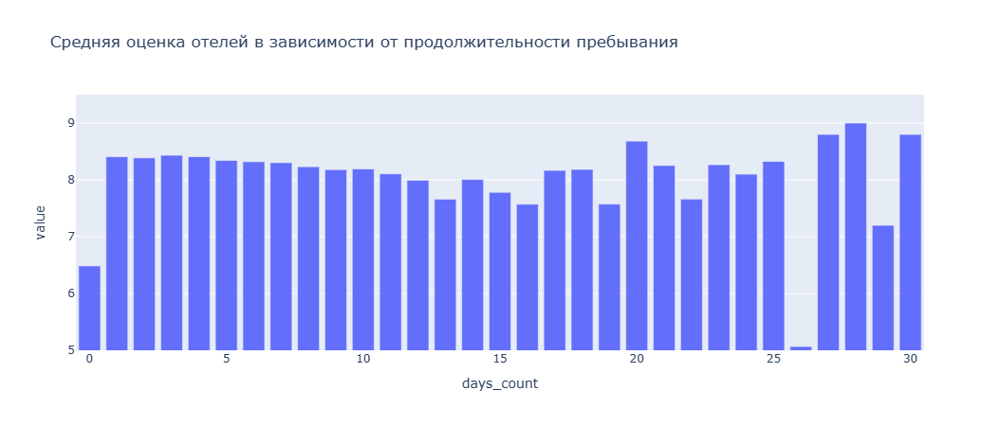

In [234]:
# сводная таблица дней прибывания и средних оценок 
piv_nation = pd.pivot_table(
                    data[data['sample']==1],
                    index='days_count',
                    values='reviewer_score',
                    aggfunc='mean',
                    )
piv_nation

# Визуализируем зависимость средней оценки 
fig = px.bar(
    data_frame=piv_nation,
    title='Средняя оценка отелей в зависимости от продолжительности пребывания',
    width=800,
)
fig.update_layout(showlegend = False)
fig.update_yaxes(range=[5, 9.5]) 
fig.show()

До 11 дней прослеживается зависимость, что первые чем дольше человек в отеле, тем оценка немного снижается, а вот потом начинается случайная гребенка, посмотрим на количество оценок в разрезе дней пребывания.

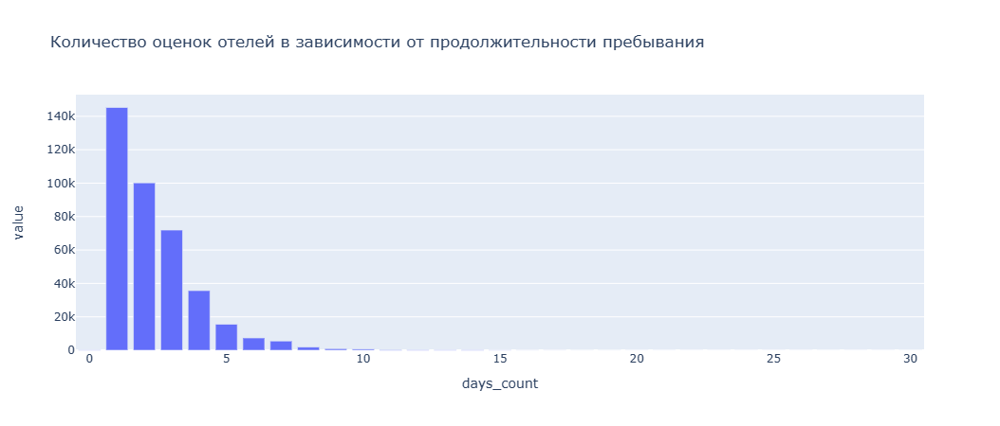

In [235]:
# сводная таблица дней прибывания и количества оценок 
piv_nation = pd.pivot_table(
                    data[data['sample']==1],
                    index='days_count',
                    values='reviewer_score',
                    aggfunc='count',
                    )
piv_nation

# Визуализируем 
fig = px.bar(
    data_frame=piv_nation,
    title='Количество оценок отелей в зависимости от продолжительности пребывания',
    width=800,
)
fig.update_layout(showlegend = False)
fig.show()

Предположение подтвердилось, дальше 10 дней, оценок становится достаточно мало, чтобы делать выводы о зависимости.

Посмотрим, что осталось от тегов:

In [236]:
data['tags'].value_counts().head(50)

[ ' Couple ', ' Double Room ', , ]                          12230
[ ' Couple ', ' Standard Double Room ', , ]                 11599
[ ' Couple ', ' Superior Double Room ', , ]                 11598
[ ' Couple ', ' Deluxe Double Room ', , ]                    9179
[ ' Couple ', ' Double Room ', ]                             8305
[ ' Couple ', ' Standard Double Room ', ]                    7096
[ ' Couple ', ' Superior Double Room ', ]                    6968
[ ' Couple ', ' Double or Twin Room ', , ]                   6761
[ ' Couple ', ' Classic Double Room ', , ]                   5641
[ ' Couple ', ' Deluxe Double Room ', ]                      5394
[ ' Couple ', ' Standard Double or Twin Room ', , ]          5325
[ ' Couple ', ' Double or Twin Room ', ]                     4698
[ ' Solo traveler ', ' Single Room ', ]                      4551
[ ' Couple ', ' Superior Double or Twin Room ', , ]          4444
[ ' Couple ', ' Classic Double Room ', ]                     3988
[ ' Solo t

In [237]:
data_copy4 = data.copy()
data_copy4.head(2)

,hotel_address,additional_number_of_scoring,review_date,average_score,hotel_name,reviewer_nationality,negative_review,review_total_negative_word_counts,total_number_of_reviews,positive_review,...,sub-region_11,sub-region_12,sub-region_13,sub-region_14,sub-region_15,sub-region_16,Business_trip,with_pet,mobile,days_count
0,Stratton Street Mayfair Westminster Borough London W1J 8LT United Kingdom,581,2/19/2016,8.4,The May Fair Hotel,United Kingdom,Leaving,3,1994,Staff were amazing,...,0,0,0,0,0,0,0,0,1,2
1,130 134 Southampton Row Camden London WC1B 5AF United Kingdom,299,1/12/2017,8.3,Mercure London Bloomsbury Hotel,United Kingdom,poor breakfast,3,1361,location,...,0,0,0,0,0,0,1,0,0,1


In [238]:
data = data_copy4.copy()

Проверим везде ли теги остались из 2х элементов

In [239]:
df = pd.DataFrame()
df['length_tag'] = data['tags'].apply(lambda x: len(x.split("', '")))
df['length_tag'].describe()

count    515431.000000
mean          1.999627
std           0.019297
min           1.000000
25%           2.000000
50%           2.000000
75%           2.000000
max           2.000000
Name: length_tag, dtype: float64

Видим, что в большинстве тагов осталось по 2 элемента: класс номера и размер компании, но все же кое где есть только 1 элемент, посмотрим на такие записи:

In [240]:
data[df['length_tag']!=2]['tags'].value_counts()

[ ' Couple ', ]                        41
[ ' Couple ']                          34
[ ' Solo traveler ', ]                 27
[ ' Solo traveler ']                   17
[ ' Family with young children ', ]    15
[ ' Group ']                           14
[ ' Group ', ]                         11
[ ' Family with young children ']       9
[ ' Family with older children ']       5
[' Couple ']                            3
[ ' Family with older children ', ]     3
[' Couple ', ]                          3
[ ' Travelers with friends ', ]         2
[' Group ']                             2
[' Family with older children ', ]      1
[' Family with young children ']        1
[' Family with young children ', ]      1
[  ' Couple ']                          1
[  ' Group ']                           1
[' Solo traveler ', ]                   1
Name: tags, dtype: int64

Все такие записи с пропусками именно в классе номера.

### Размер группы 

In [241]:
data['tags'] = data['tags'].apply(lambda x: x.replace('[', '').replace(']', '').replace("'", ''))
data['group_size'] = data['tags'].apply(lambda x: x.split(',')[0].strip())
data['group_size'].value_counts()

Couple                        252128
Solo traveler                 108476
Group                          65361
Family with young children     60989
Family with older children     26334
Travelers with friends          2143
Name: group_size, dtype: int64

Отлично, получили всего 6 видов размера группы постояльцев, посмотрим на взаимосвязь с таргетом

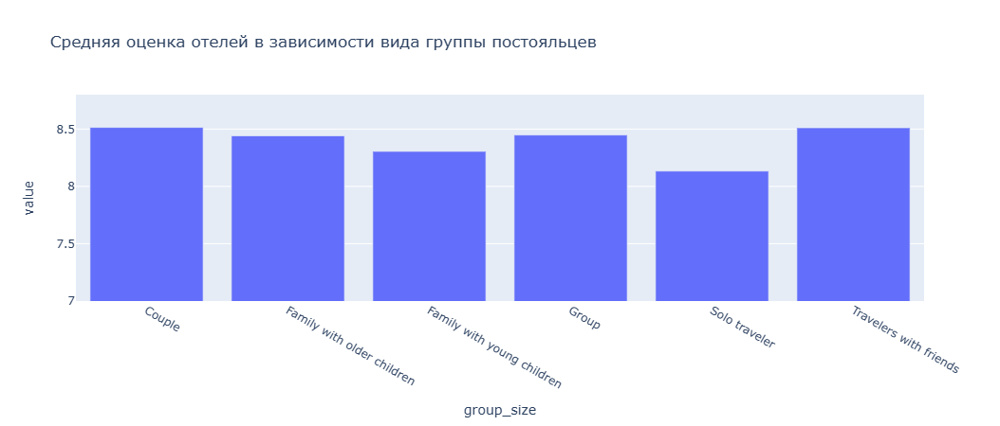

In [242]:
# сводная таблица  по видам групп постояльцев
piv_nation = pd.pivot_table(
                    data[data['sample']==1],
                    index='group_size',
                    values='reviewer_score',
                    aggfunc='mean',
                    )
piv_nation

# Визуализируем зависимость средней оценки 
fig = px.bar(
    data_frame=piv_nation,
    title='Средняя оценка отелей в зависимости вида группы постояльцев',
    width=800,
)
fig.update_layout(showlegend = False)
fig.update_yaxes(range=[7, 8.8]) 
fig.show()

Зависимость определенно есть, закодируем признак.

In [243]:
ohe_encoder = ce.OneHotEncoder(cols=['group_size']) 
type_bin = ohe_encoder.fit_transform(data['group_size'])
data = pd.concat([data, type_bin], axis=1)

In [244]:
data_copy5 = data.copy()
data_copy5.head(2)

,hotel_address,additional_number_of_scoring,review_date,average_score,hotel_name,reviewer_nationality,negative_review,review_total_negative_word_counts,total_number_of_reviews,positive_review,...,with_pet,mobile,days_count,group_size,group_size_1,group_size_2,group_size_3,group_size_4,group_size_5,group_size_6
0,Stratton Street Mayfair Westminster Borough London W1J 8LT United Kingdom,581,2/19/2016,8.4,The May Fair Hotel,United Kingdom,Leaving,3,1994,Staff were amazing,...,0,1,2,Couple,1,0,0,0,0,0
1,130 134 Southampton Row Camden London WC1B 5AF United Kingdom,299,1/12/2017,8.3,Mercure London Bloomsbury Hotel,United Kingdom,poor breakfast,3,1361,location,...,0,0,1,Couple,1,0,0,0,0,0


In [245]:
data = data_copy5.copy()

### Тип номера

Теперь выделим часть тэга с типом номера.

In [246]:
data['room_type'] = data['tags'].apply(lambda x: x.split(',')[1].strip() if len(x.split(','))>1 else np.nan)
room_list = list(data['room_type'].value_counts().index)
data['room_type'].value_counts().head(1425)

Double Room                            35207
Standard Double Room                   32247
Superior Double Room                   31361
Deluxe Double Room                     24812
Double or Twin Room                    22393
                                       ...  
Large Double or Twin Room                 10
Standard Duplex Room 3 Adults             10
Single Room with Bathroom                 10
Queen Suite                               10
Deluxe Double Room 2 Adults 1 Child       10
Name: room_type, Length: 1425, dtype: int64

2388 уникальных наименования - слишком много, чтобы кодировать для модели, давайте попробуем разбить номера на несколько категорий, однако изучив общепринятую классификацию, понимаем, что наши данные, во-первых, имеют много лишних слов в наименовании, во вторых имеют иногда сразу по 2 типа в одном, например, 'Executive'  и 'King'. Так что просто отсортировать на условно 10 общепринятых типов будет не совсем корректно, плюс может быть несколько подтипов одного типа номеров кардинально отличаются по рейтингу, поступим по другому: отсортируем данные (оригинал не трогаем, создадим сводную таблицу) по уменьшению среднего рейтинга в разрезе типа номера и разобьем на диапазоны по оценкам. Эти диапазоны и будут определять классы наших номеров, то есть мы получим не совсем признак класса номера, а скорее разбиение типа номеров по рейтингу.


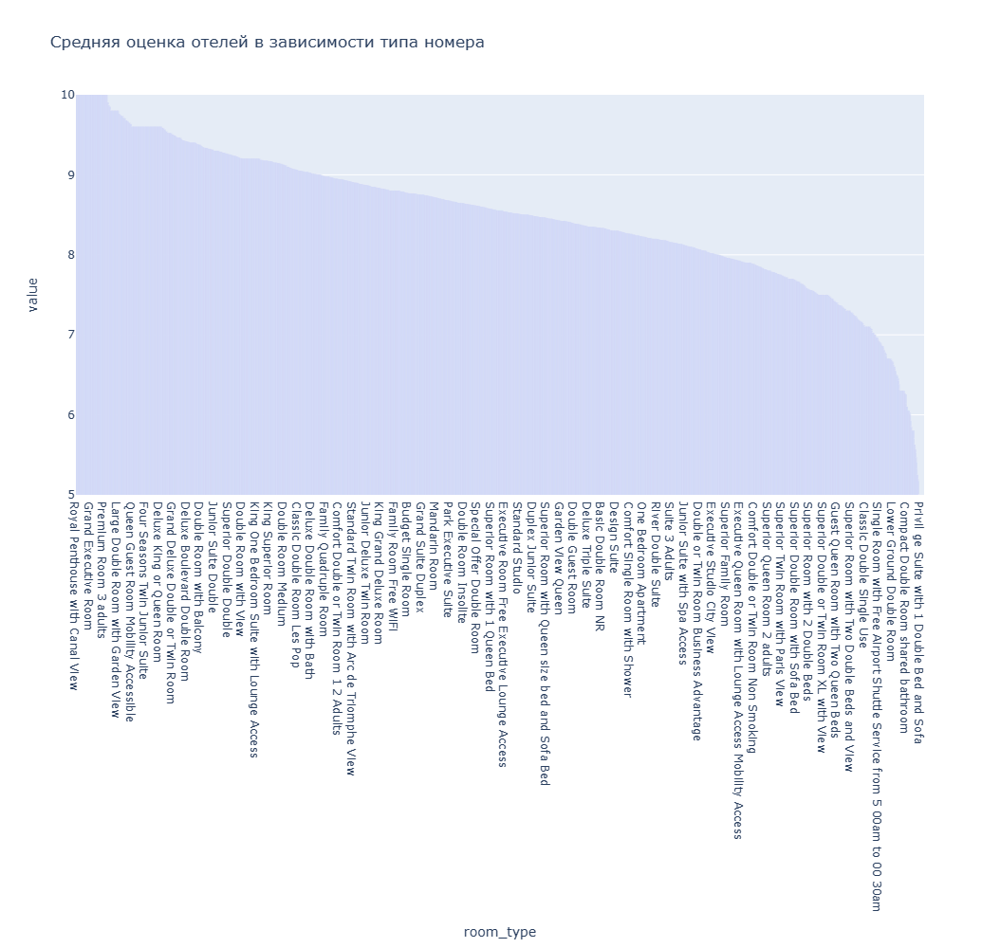

In [247]:
# сводная таблица  по типам номеров
piv_nation = pd.pivot_table(
                    data[(data['sample']==1) & (data['room_type'].isin(room_list)) ],
                    index='room_type',
                    values='reviewer_score',
                    aggfunc='mean',
                    )
# сохраним отсортированный по убывнию рейтинга список типов номеров, для будущего разбиения типов на 21 класс
piv_nation = piv_nation.reindex(piv_nation.sort_values(by='reviewer_score', ascending=False).index)
room_type_list = list(piv_nation.index)
# Визуализируем зависимость средней оценки 
fig = px.bar(
    data_frame=piv_nation,
    title='Средняя оценка отелей в зависимости типа номера',
    width=1500,
    height=1000
)
fig.update_layout(showlegend = False)
fig.update_yaxes(range=[5, 10]) 
fig.show()

# print(room_type_list)

In [248]:
def room_typer(x):
    # Разбиваем все типы номеров на 23 подкласса по значению рейтинга
    try:
        ind = room_type_list.index(x)
    except ValueError:
        return 22
    if  ind in range(96): # первый подкласс - 10ки
        return 0
    elif ind in range(96,171):
        return 1
    elif ind in range(171,271):
        return 2
    else:
        # остальное бьем на равные отрезки
        delta = (len(room_type_list) - 270) // 18
        for i in range(3,22):
            if ind in range(271+((i-3)*delta), 271+((i-2)*delta)):
                return i
    
    

    
data['room_type_ind'] = data['room_type'].apply(room_typer)
data['room_type_ind'].describe()
    

count    515431.000000
mean         11.858441
std           3.036268
min           0.000000
25%          10.000000
50%          12.000000
75%          14.000000
max          22.000000
Name: room_type_ind, dtype: float64

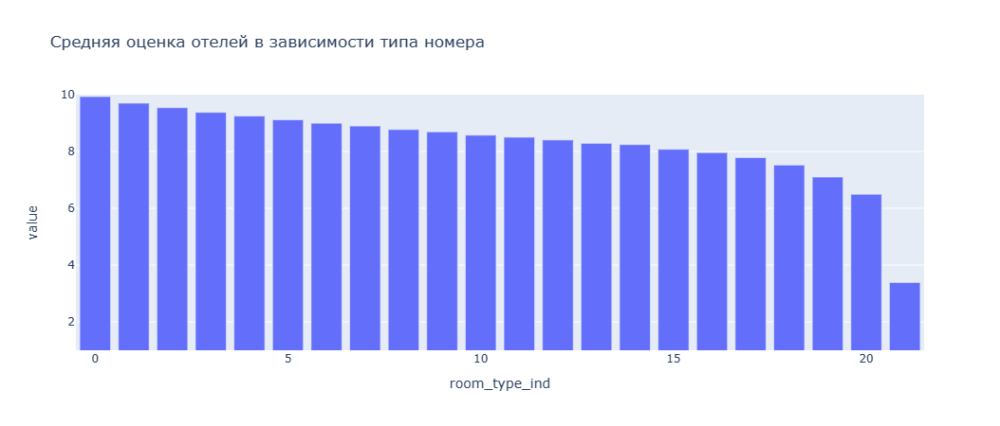

In [249]:
# сводная таблица  по классам типов номеров
piv_nation = pd.pivot_table(
                    data[(data['sample']==1) & (data['room_type'].isin(room_list)) ],
                    index='room_type_ind',
                    values='reviewer_score',
                    aggfunc='mean',
                    )

# Визуализируем зависимость средней оценки 
fig = px.bar(
    data_frame=piv_nation,
    title='Средняя оценка отелей в зависимости типа номера',
    width=1500,
)
fig.update_layout(showlegend = False)
fig.update_yaxes(range=[1, 10]) 
fig.show()

### 

In [250]:
data_copy6 = data.copy()
data_copy6.head(2)

,hotel_address,additional_number_of_scoring,review_date,average_score,hotel_name,reviewer_nationality,negative_review,review_total_negative_word_counts,total_number_of_reviews,positive_review,...,days_count,group_size,group_size_1,group_size_2,group_size_3,group_size_4,group_size_5,group_size_6,room_type,room_type_ind
0,Stratton Street Mayfair Westminster Borough London W1J 8LT United Kingdom,581,2/19/2016,8.4,The May Fair Hotel,United Kingdom,Leaving,3,1994,Staff were amazing,...,2,Couple,1,0,0,0,0,0,Studio Suite,6
1,130 134 Southampton Row Camden London WC1B 5AF United Kingdom,299,1/12/2017,8.3,Mercure London Bloomsbury Hotel,United Kingdom,poor breakfast,3,1361,location,...,1,Couple,1,0,0,0,0,0,Standard Double Room,14


In [251]:
data = data_copy6.copy()

## Отзывы

negative_review - отрицательный отзыв, который рецензент дал отелю.

review_total_negative_word_counts - общее количество слов в отрицательном отзыв

positive_review - положительный отзыв, который рецензент дал отелю

review_total_positive_word_counts - общее количество слов в положительном отзыве

Первым делом посмотрим на, что чаще всего встречается в отрицательных и положительных отзывах.

In [252]:
data['negative_review'].value_counts().head(40)

No Negative                  127816
 Nothing                      14291
 Nothing                       4234
 nothing                       2223
 N A                           1037
 None                           984
                                849
 N a                            509
 Breakfast                      407
 Small room                     373
 Location                       367
 Everything                     325
 All good                       318
 Nothing really                 315
 none                           302
 nothing                        283
 No complaints                  274
 Price                          260
 Nothing really                 254
 Nil                            247
 n a                            227
 Nothing at all                 221
 Nothing to dislike             209
 Nothing at all                 194
 Small rooms                    188
 None                           182
 No complaints                  176
 All good                   

In [253]:
data['positive_review'].value_counts().head(40)

No Positive                35924
 Location                   9213
 Everything                 2284
 location                   1674
 Nothing                    1242
 The location               1124
 Great location             1045
 Good location               927
 Location                    915
 Everything                  613
 Breakfast                   608
 Friendly staff              514
 Staff                       453
 Excellent location          392
 Great location              372
 Location and staff          333
 everything                  319
 Good location               275
 Nothing                     224
 Comfy bed                   222
 nothing                     217
 The location                215
 good location               206
 The staff                   197
 Good breakfast              189
                             183
 Location staff              180
 the location                180
 Location was great          178
 Location was good           178
 All      

Видим, что много задвоений из-за пробелов и регистра, сразу это исправим.

In [254]:
data['negative_review'] = data['negative_review'].apply(lambda x: x.strip().lower())
data['positive_review'] = data['positive_review'].apply(lambda x: x.strip().lower())
display(data['negative_review'].value_counts().head(40))
print()
display(data['positive_review'].value_counts().head(40))

no negative                  127816
nothing                       21177
n a                            1815
none                           1501
                                849
nothing really                  655
small room                      570
breakfast                       545
all good                        544
no complaints                   523
location                        501
nothing at all                  466
everything                      419
nothing to dislike              373
price                           348
nil                             332
small rooms                     307
everything was perfect          276
na                              272
can t think of anything         250
leaving                         244
absolutely nothing              242
everything was great            222
expensive                       206
nothing to complain about       205
no                              200
room size                       200
very small room             

no positive                      35924
location                         11933
everything                        3314
nothing                           1729
great location                    1685
the location                      1604
good location                     1495
breakfast                          795
friendly staff                     732
excellent location                 639
staff                              553
location and staff                 452
location staff                     432
location location location         345
location was great                 328
good breakfast                     316
everything was perfect             316
location was good                  312
comfy bed                          303
perfect location                   287
the staff                          280
location is great                  278
location is good                   256
all                                250
clean                              237
every thing              

Теперь посмотрим на особенности в отзывах:
- если в отзыве слово, например 'nothing' и ему подобные, то это меняет смысл отзыва (например 'nothing' в негативных значит что все хорошо),
- может быть просто пробел вместо отзыва,
- в случае отсутствия отзыва клиента имеем значение 'no negative/no positive'.

Сразу обработаем второй пункт - заменим отзывы из 1 пробела на пустую строку.

In [255]:
data.loc[data[data.negative_review == ' '].index,'negative_review'] = ''
data.loc[data[data.positive_review == ' '].index,'positive_review'] = ''

Теперь разберемся с первым пунктом, чтобы потом не было проблем с семантическим анализом, уберем (заменим на "") ситуации, когда в положительном стоит nothing, а отзыв отрицательный, и зеркальную ситуацию с негативным.

Для этого сначала посмотрим что чаще всего встречается в таких ситуациях.

In [256]:
data[(data['sample'] == 1) & (data['review_total_negative_word_counts'] > 0)
                         & (data['reviewer_score'] > 9)].negative_review.value_counts().head(100).index

Index(['nothing', 'n a', 'none', '', 'nothing really', 'all good',
       'nothing at all', 'no complaints', 'nothing to dislike', 'nil',
       'everything was perfect', 'absolutely nothing', 'leaving',
       'everything was great', 'can t think of anything', 'na',
       'nothing to complain about', 'breakfast', 'nothing not to like',
       'having to leave', 'no', 'nothing everything was perfect', 'small room',
       'liked everything', 'i liked everything', 'nothing it was perfect',
       'price', 'nothing all good', 'everything was good', 'not much',
       'nothing everything was great', 'location', 'everything', 'non',
       'all was good', 'there was nothing i didn t like', 'not applicable',
       'everything was fine', 'not a thing', 'no complaints at all',
       'expensive', 'no negatives', 'nothing to report',
       'there was nothing to dislike', 'expensive breakfast', 'no thing',
       'we liked everything', 'loved everything', 'nothing comes to mind',
       'sma

In [257]:
data[(data['sample'] == 1) & (data['review_total_positive_word_counts'] > 0)
                         & (data['reviewer_score'] < 5)].positive_review.value_counts().head(100).index

Index(['nothing', 'location', 'the location', 'good location', 'breakfast',
       'not much', 'location only', 'location was good', 'only the location',
       'not a lot', 'nothing at all', 'location is good', 'great location',
       'leaving', 'only location', 'breakfast was good', 'friendly staff',
       'nothing really', 'clean', 'the location was good', 'none',
       'the bed was comfortable', 'position', 'nothing special', 'staff',
       'location was ok', 'absolutely nothing', 'the location only', '',
       'the bed was comfy', 'location good', 'no thing',
       'the location is great', 'breakfast was ok', 'the breakfast was good',
       'good breakfast', 'very little', 'the location is good', 'it was clean',
       'staff were friendly', 'just the location', 'nice location',
       'comfortable bed', 'the staff', 'the room', 'location is great',
       'the bed', 'comfy bed', 'the breakfast', 'location was great',
       'central location', 'checking out', 'bed was comf

создадим списки, что будем удалять:

In [258]:
meaningless_in_negative = ['nothing', 'n a', 'none', 'nothing really', 'all good',
                           'no complaints', 'nothing at all', 'nothing to dislike', 'nil',
                           'everything was perfect', 'na','absolutely nothing', 'leaving',
                           'everything was great', 'can t think of anything', 'nothing to complain about', 
                           'nothing not to like', 'having to leave', 'no', 'everything was good',
                           'nothing all good', 'i liked everything', 'liked everything', 'nothing everything was perfect',
                           'not much', 'nothing it was perfect', 'nothing everything was great',
                           'non', 'everything was fine', 'all was good', 'everything', 'not applicable',
                           'there was nothing i didn t like', 'nothing comes to mind',
                           'not a thing', 'nothing in particular', 'no complaints at all',
                           'no negatives', 'nothing to report', 'there was nothing to dislike',
                           'it was all good', 'we liked everything', 'no thing', 'there was nothing we didn t like',
                           'nothing i didn t like', 'loved everything', 'nothing i can think of', 'nothing bad to say',
                           'no issues', 'no dislikes', 'no problems', 'nothing to say', 'there was nothing not to like',
                           'all ok', 'nothing to complain', 'no comment', 'nothing could have been better',
                           'nada', 'all ok', 'all great', 'no issues', 'everything was excellent', 'liked it all',
                           'no dislikes', 'that we had to leave',
                           'nothing to complain', 'no problems', 'nothing bad',
                           'i loved everything', 'nothing we didn t like',
                           'there wasn t anything we didn t like', 'no comment',
                           'couldn t fault it', 'it was perfect', 'loved it all',
                           'nothing to not like', 'everything was ok', 'what s not to like', 'nothing it was all good',
                           'nothing negative to say', 'all was perfect',
                           'that i couldn t stay longer', 'that we couldn t stay longer',
                           'nothing to fault', '', 'no negative',
                          ]
meaningless_in_positive = ['nothing', 'not much', 
                           'not a lot', 'nothing at all', 
                           'nothing really', 'none','nothing special', 'absolutely nothing',  '',
                           'no thing', 'very little',  'checking out', 'nothing much', 
                           'nothing to like', 'almost nothing', 'everything', 'nothing in particular',
                           'no', 'n a', 'not much really', 'nothing to be honest', 'not alot', 'no positive']

Выше мы создали списки отзывов, которые не несут смысл или имеет ввиду обратное, также много таких отзывов начинается с "nothing" заменим на '' и такие, и заодно пересчитаем поля с количеством слов в отзывах

In [259]:
def clear_meaningless(x, meaningless):
    for word in meaningless:
        if x == word:
            return ''
    if x.startswith('nothing'):
        return ''
    return x


data['negative_review_cleaned'] =data['negative_review'].apply(lambda x: clear_meaningless(x, meaningless_in_negative))
data['review_total_negative_word_counts_cleaned'] = data.apply(lambda x: 0 if x.negative_review_cleaned=='' else x.review_total_negative_word_counts, axis=1)
data['positive_review_cleaned'] = data['positive_review'].apply(lambda x: clear_meaningless(x, meaningless_in_positive))
data['review_total_positive_word_counts_cleaned'] = data.apply(lambda x: 0 if x.positive_review_cleaned=='' else x.review_total_positive_word_counts, axis=1)

In [260]:
drop_columns.append('review_total_positive_word_counts')
drop_columns.append('review_total_negative_word_counts')

В отчете ProfileReport можно посмотреть какаие слова ниболее часто встречались в отзывах:

In [261]:
report = ProfileReport(data[['negative_review_cleaned', 'positive_review_cleaned']])
report

Видим, что люди частно оценивают:
- 'room', 'shower', 'beds'
- 'breakfast', 'restaurant', ' bar '
- 'location', 'area'
- 'hotel'
- 'wifi'
- 'clean', 'cleanliness'
- 'staff'

Вынесим в отдельные признаки, значение которого будет зависеть от в негативном или позитивном отзыве было слово, при этом будем увеличивать или уменьшать оценку в зависимости от наличие прилагательных (Плохой, хороший, отличный, чистый, и.т.д). 
Здесь хочется отметить, алгоритм корректировки оценки по прилагательным не идеален, и в длинных отзывах может быть ситуация, когда прилагательное будет относится не к данному признаку а к другому, для этого например можно было рассчитывать расстояние от прилагательного до признака, и принимать решение, относится оно к нему или нет, но во-первых подавляющее количество отзывов именно короткое и относится к 1 признаку, а во-вторых, на практике особого прироста метрике такая обработка не дала, а время выполнения значительно повышается, поэтому опустим данное замечание)

In [262]:
data_copy7 = data.copy()
data_copy7.head(2)

,hotel_address,additional_number_of_scoring,review_date,average_score,hotel_name,reviewer_nationality,negative_review,review_total_negative_word_counts,total_number_of_reviews,positive_review,...,group_size_3,group_size_4,group_size_5,group_size_6,room_type,room_type_ind,negative_review_cleaned,review_total_negative_word_counts_cleaned,positive_review_cleaned,review_total_positive_word_counts_cleaned
0,Stratton Street Mayfair Westminster Borough London W1J 8LT United Kingdom,581,2/19/2016,8.4,The May Fair Hotel,United Kingdom,leaving,3,1994,staff were amazing,...,0,0,0,0,Studio Suite,6,,0,staff were amazing,4
1,130 134 Southampton Row Camden London WC1B 5AF United Kingdom,299,1/12/2017,8.3,Mercure London Bloomsbury Hotel,United Kingdom,poor breakfast,3,1361,location,...,0,0,0,0,Standard Double Room,14,poor breakfast,3,location,2


In [263]:
data = data_copy7.copy()

In [264]:
# Выделем из отзыва объекты оценки людей, для каждого объекта определим слова усиливающие положительную или отрицательную оценку

def food(x):
    category_words = ['breakfast', 'restaurant', 'bar']
    good_words = ['excellent', 'good', 'great']
    bad_words = ['expensive']
    return check_words(x, category_words)

def staff(x):
    category_words = ['staff', 'reception', 'service', 'lobby']
    good_words = ['friendly', 'helpful', 'great']
    return check_words(x, category_words, good_words)

def room(x):
    category_words = ['room', 'bed','beds', 'bathroom', 'shower', 'wifi']
    good_words = ['clean', 'cleanliness', 'big', 'fast']
    bad_words = ['noisy', 'small', 'dirty']
    return check_words(x, category_words, good_words, bad_words)

def location(x):
    category_words = ['location', 'area', 'station', 'metro']
    good_words = ['excellent', 'good', 'great']
    return check_words(x, category_words, good_words)

def price(x):
    category_words = ['price']
    good_words = ['cheap']
    bad_words = ['expensive']
    return check_words(x, category_words, good_words, bad_words)

def is_perfect(x):
    # вынесим в отдельный признак наличие 'perfect', 'everything' в отзыве
    good_words = ['perfect', 'everything']
    for word in good_words:
        if word in x.positive_review_cleaned:
            return 1
    return 0



def check_words(x,category_words, good_words=None, bad_words=None):
    score = 0
    for word in category_words:
        
        if word in x.positive_review_cleaned:
            score = 0
            if good_words:
                for word in good_words:
                    if word in x.positive_review_cleaned or word in x.negative_review_cleaned:
                        score+=0.2     
#             if bad_words:
#                 for word in bad_words:
#                     if word in x.positive_review_cleaned or word in x.negative_review_cleaned:
#                         score-=0.2    
            
            return 1 + score
        
        if word in x.negative_review_cleaned:
            score = 0    
#             if good_words:
#                 for word in good_words:
#                     if word in x.positive_review_cleaned or word in x.negative_review_cleaned:
#                         score+=0.2      
            if bad_words:
                for word in bad_words:
                    if word in x.positive_review_cleaned or word in x.negative_review_cleaned:
                        score-=0.2            
            
            
            return score-1
    
    return 0

In [265]:
data['food'] = data.apply(food, axis=1)
data['staff'] = data.apply(staff, axis=1)
data['room'] = data.apply(room, axis=1)
data['price'] = data.apply(price, axis=1)
data['location'] = data.apply(location, axis=1)
data['is_perfect'] = data.apply(is_perfect, axis=1)

Здесь хочу отметить, делал несколько вариантов и лучшим по метрике оказался:
- шаг коррекции признака прилагательными 0.2
- коррекция положительного отзыва только в положительную сторону, а отрицательного в отрицательную.

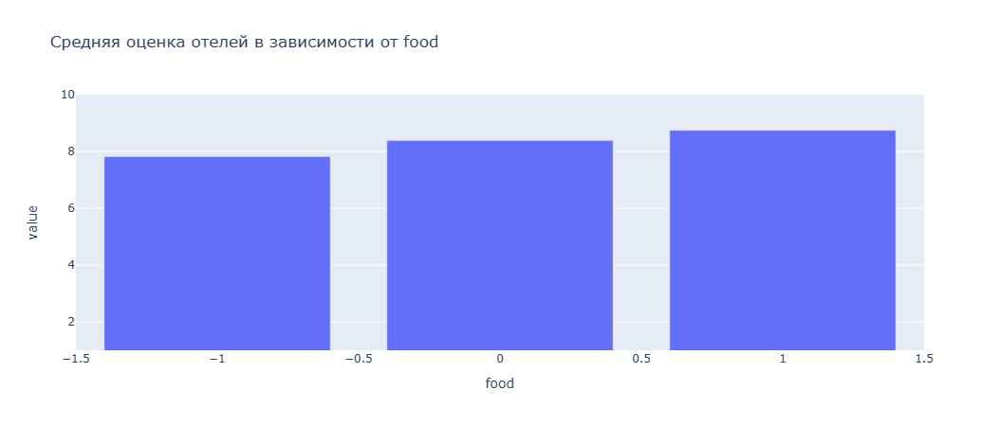

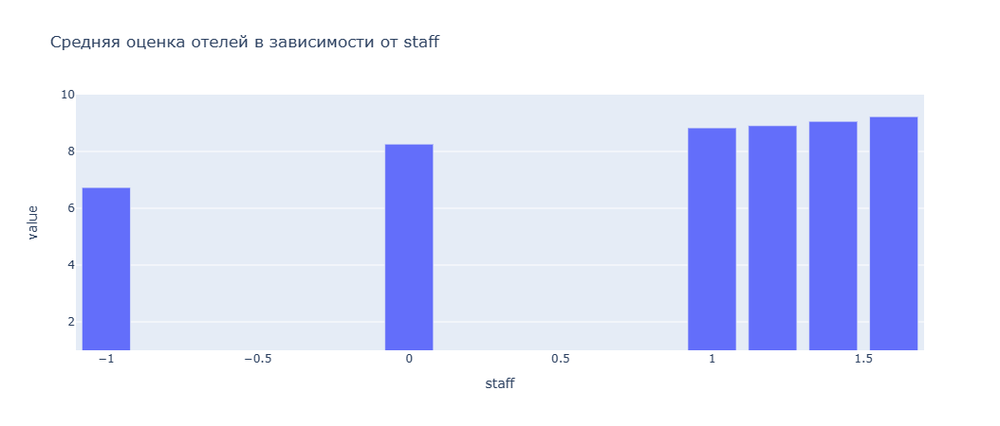

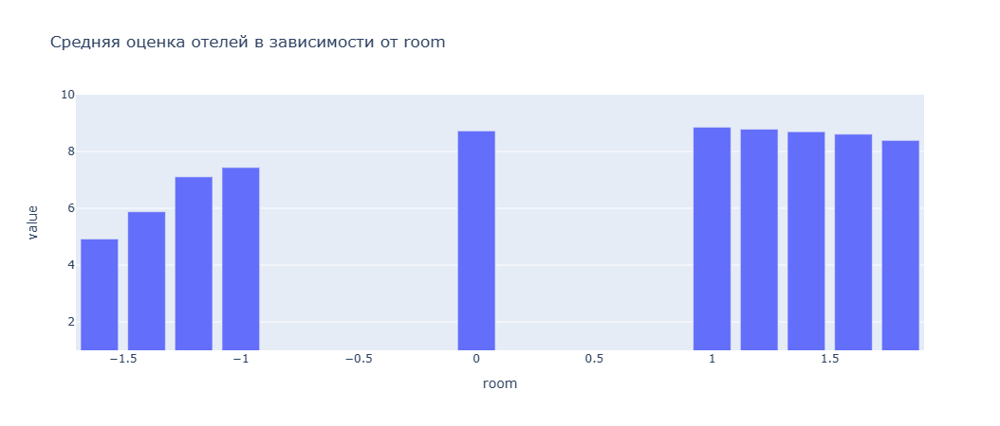

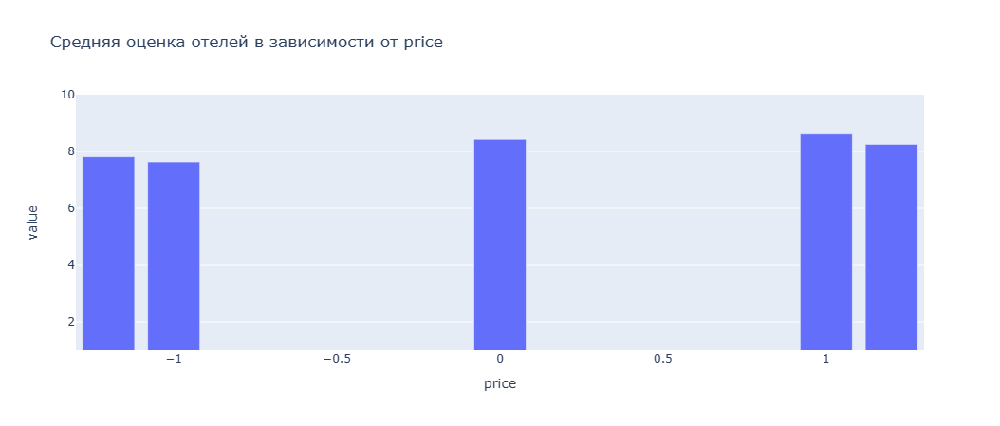

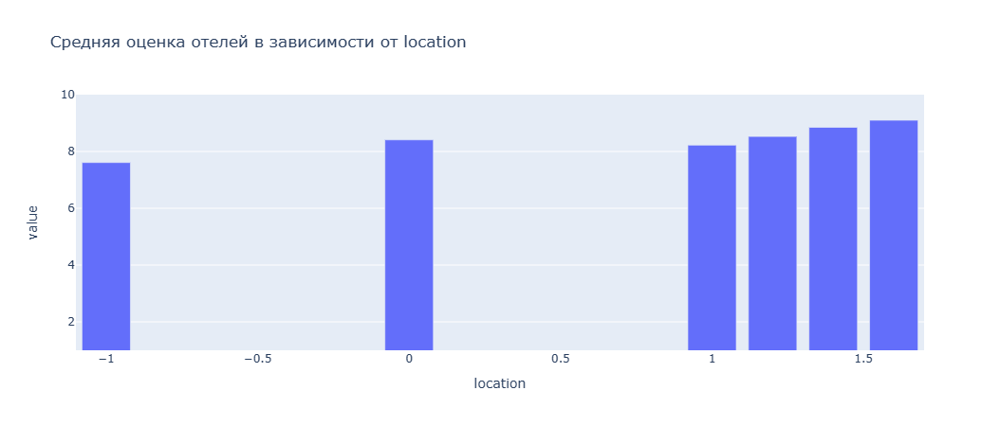

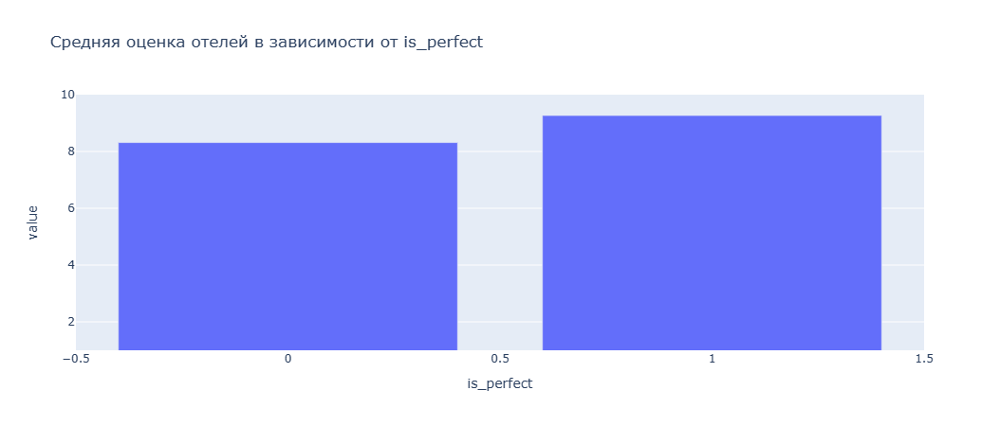

In [266]:
for feature in ['food','staff','room','price','location','is_perfect']:
    # сводная таблица  
    piv_nation = pd.pivot_table(
                        data[(data['sample']==1) & (data['room_type'].isin(room_list)) ],
                        index=feature,
                        values='reviewer_score',
                        aggfunc='mean',
                        )

    # Визуализируем зависимость средней оценки 
    fig = px.bar(
        data_frame=piv_nation,
        title=f'Средняя оценка отелей в зависимости от {feature}',
        width=800,
    )
    fig.update_layout(showlegend = False)
    fig.update_yaxes(range=[1, 10]) 
    fig.show()  


Теперь рассчитаем общие метрики отзыва:
- разница в количестве слов в положительном и отрицательном;
- сумму слов в обоих отзывах;
- отношение длины хорошего отзыва к плохому.

In [267]:
data_copy8 = data.copy()
data_copy8.head(2)

,hotel_address,additional_number_of_scoring,review_date,average_score,hotel_name,reviewer_nationality,negative_review,review_total_negative_word_counts,total_number_of_reviews,positive_review,...,negative_review_cleaned,review_total_negative_word_counts_cleaned,positive_review_cleaned,review_total_positive_word_counts_cleaned,food,staff,room,price,location,is_perfect
0,Stratton Street Mayfair Westminster Borough London W1J 8LT United Kingdom,581,2/19/2016,8.4,The May Fair Hotel,United Kingdom,leaving,3,1994,staff were amazing,...,,0,staff were amazing,4,0,1.0,0.0,0.0,0.0,0
1,130 134 Southampton Row Camden London WC1B 5AF United Kingdom,299,1/12/2017,8.3,Mercure London Bloomsbury Hotel,United Kingdom,poor breakfast,3,1361,location,...,poor breakfast,3,location,2,-1,0.0,0.0,0.0,1.0,0


In [268]:
data = data_copy8.copy()

In [269]:
data['comment_words_diff'] = data['review_total_positive_word_counts_cleaned'] - data['review_total_negative_word_counts_cleaned']
data['comment_words_sum'] = data['review_total_positive_word_counts_cleaned'] + data['review_total_negative_word_counts_cleaned']
data['positive_percent'] = 0
data['diff_percent'] = 0


In [270]:
data.loc[data['comment_words_sum'] != 0, 'positive_percent'] = data.loc[data['comment_words_sum'] != 0,'review_total_positive_word_counts_cleaned']*100/data.loc[data['comment_words_sum'] != 0,'comment_words_sum']
data.loc[data['comment_words_sum'] != 0, 'diff_percent'] = data.loc[data['comment_words_sum'] != 0,'comment_words_diff']*100/data.loc[data['comment_words_sum'] != 0,'comment_words_sum']

Теперь, последним этапом в работе с отзывами, используем для наших отзывов модель Vader (Valence Aware Dictionary for Sentiment Reasoning) их библиотеки nltk.
Она предназначена для анализа тональности текста, которая чувствительна как к полярности (положительная / отрицательная), так и к интенсивности (силе) эмоций. 

Однако у таких моделей есть проблема, они анализируют слова и поэтому фразы типа "non", "no positive", "no negative" (которые у нас достаточно часто встречаются), будут проанализированы не правильно, исправим это заменив их на явные слова "negative" / "positive".

In [271]:
# определим констаты для замены  некорректо воспринимаемых моделью vader слов на явно указывающие оценку слова
positive = 'positive '
negative = 'negative '
meaningless_in_negative = ['nothing', 'n a', 'none', 'nothing really', 'all good',
                           'no complaints', 'nothing at all', 'nothing to dislike', 'nil',
                           'everything was perfect', 'na','absolutely nothing', 'leaving',
                           'everything was great', 'can t think of anything', 'nothing to complain about', 
                           'nothing not to like', 'having to leave', 'no', 'everything was good',
                           'nothing all good', 'i liked everything', 'liked everything', 'nothing everything was perfect',
                           'not much', 'nothing it was perfect', 'nothing everything was great',
                           'non', 'everything was fine', 'all was good', 'everything', 'not applicable',
                           'there was nothing i didn t like', 'nothing comes to mind',
                           'not a thing', 'nothing in particular', 'no complaints at all',
                           'no negatives', 'nothing to report', 'there was nothing to dislike',
                           'it was all good', 'we liked everything', 'no thing', 'there was nothing we didn t like',
                           'nothing i didn t like', 'loved everything', 'nothing i can think of', 'nothing bad to say',
                           'no issues', 'no dislikes', 'no problems', 'nothing to say', 'there was nothing not to like',
                           'all ok', 'nothing to complain', 'no comment', 'nothing could have been better',
                           'nada', 'all ok', 'all great', 'no issues', 'everything was excellent', 'liked it all',
                           'no dislikes', 'that we had to leave',
                           'nothing to complain', 'no problems', 'nothing bad',
                           'i loved everything', 'nothing we didn t like',
                           'there wasn t anything we didn t like', 'no comment',
                           'couldn t fault it', 'it was perfect', 'loved it all',
                           'nothing to not like', 'everything was ok', 'what s not to like', 'nothing it was all good',
                           'nothing negative to say', 'all was perfect',
                           'that i couldn t stay longer', 'that we couldn t stay longer',
                           'nothing to fault', '', 'no negative',
                          ]
meaningless_in_positive = ['nothing', 'not much', 
                           'not a lot', 'nothing at all', 
                           'nothing really', 'none','nothing special', 'absolutely nothing',  '',
                           'no thing', 'very little',  'checking out', 'nothing much', 
                           'nothing to like', 'almost nothing', 'everything', 'nothing in particular',
                           'no', 'n a', 'not much really', 'nothing to be honest', 'not alot', 'no positive']


def get_negative_review_for_senti(x):
    # Если отзыв не несет правильно воспринимаемого моделью значния заменяем на наши константы
    replace_dict = {x: positive*3 for x in meaningless_in_negative}
    # Однако не забываем, что в неготивном отзыве некоторые фразы несут смысл, что все плохо
    replace_dict['everything'] = negative*3
    replace_dict['everything else'] = negative*3
    replace_dict['every thing'] = negative*3
    replace_dict['all'] = negative*3
    replace_dict_starts = {'nothing': positive, 'everything': positive, 'all': positive}  #was x3
    return get_review_for_senti(x, replace_dict, replace_dict_starts)


def get_positive_review_for_senti(x):
    
    replace_dict = {x: negative*3 for x in meaningless_in_positive}
    replace_dict_starts = {'nothing': negative, 'everything': positive}  #was x3
    return get_review_for_senti(x, replace_dict, replace_dict_starts)

def get_review_for_senti(x, replace_dict, replace_dict_starts):

    for key, value in replace_dict.items():
        if x == key:
            x = value
    for key, value in replace_dict_starts.items():
        if x.startswith(key) and x not in replace_dict:
            x = value
    return x

data['negative_review_for_compound'] = data['negative_review'].apply(get_negative_review_for_senti)
data['positive_review_for_compound'] = data['positive_review'].apply(get_positive_review_for_senti)

In [272]:
data_copy9 = data.copy()
data_copy9.head(2)

,hotel_address,additional_number_of_scoring,review_date,average_score,hotel_name,reviewer_nationality,negative_review,review_total_negative_word_counts,total_number_of_reviews,positive_review,...,room,price,location,is_perfect,comment_words_diff,comment_words_sum,positive_percent,diff_percent,negative_review_for_compound,positive_review_for_compound
0,Stratton Street Mayfair Westminster Borough London W1J 8LT United Kingdom,581,2/19/2016,8.4,The May Fair Hotel,United Kingdom,leaving,3,1994,staff were amazing,...,0.0,0.0,0.0,0,4,4,100.0,100.0,positive positive positive,staff were amazing
1,130 134 Southampton Row Camden London WC1B 5AF United Kingdom,299,1/12/2017,8.3,Mercure London Bloomsbury Hotel,United Kingdom,poor breakfast,3,1361,location,...,0.0,0.0,1.0,0,-1,5,40.0,40.0,poor breakfast,location


In [273]:
# Семантический анализ подготовленных отзывов
sent_analyzer = SentimentIntensityAnalyzer()

data['total_review'] = data.apply(lambda x: ' '.join([x.negative_review_for_compound, x.positive_review_for_compound]), axis=1)
data['total_review_sent'] = data['total_review'].apply(sent_analyzer.polarity_scores)

data['positive_review_for_compound_sent'] = data['positive_review_for_compound'].apply(sent_analyzer.polarity_scores)
data['negative_review_for_compound_sent'] = data['negative_review_for_compound'].apply(sent_analyzer.polarity_scores)

In [274]:
data_copy10 = data.copy()
data_copy10.head(2)

,hotel_address,additional_number_of_scoring,review_date,average_score,hotel_name,reviewer_nationality,negative_review,review_total_negative_word_counts,total_number_of_reviews,positive_review,...,comment_words_diff,comment_words_sum,positive_percent,diff_percent,negative_review_for_compound,positive_review_for_compound,total_review,total_review_sent,positive_review_for_compound_sent,negative_review_for_compound_sent
0,Stratton Street Mayfair Westminster Borough London W1J 8LT United Kingdom,581,2/19/2016,8.4,The May Fair Hotel,United Kingdom,leaving,3,1994,staff were amazing,...,4,4,100.0,100.0,positive positive positive,staff were amazing,positive positive positive staff were amazing,"{'neg': 0.0, 'neu': 0.12, 'pos': 0.88, 'compound': 0.9393}","{'neg': 0.0, 'neu': 0.345, 'pos': 0.655, 'compound': 0.5859}","{'neg': 0.0, 'neu': 0.0, 'pos': 1.0, 'compound': 0.8957}"
1,130 134 Southampton Row Camden London WC1B 5AF United Kingdom,299,1/12/2017,8.3,Mercure London Bloomsbury Hotel,United Kingdom,poor breakfast,3,1361,location,...,-1,5,40.0,40.0,poor breakfast,location,poor breakfast location,"{'neg': 0.608, 'neu': 0.392, 'pos': 0.0, 'compound': -0.4767}","{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}","{'neg': 0.756, 'neu': 0.244, 'pos': 0.0, 'compound': -0.4767}"


In [275]:
data = data_copy10.copy()

In [276]:
# Выделяем результаты анализа в отдельные признаки

data['positive_review_compound'] = data['positive_review_for_compound_sent'].apply(lambda x: x['compound'])
data['positive_review_pos'] = data['positive_review_for_compound_sent'].apply(lambda x: x['pos'])
data['positive_review_neg'] = data['positive_review_for_compound_sent'].apply(lambda x: x['neg'])

data['negative_review_compound'] = data['negative_review_for_compound_sent'].apply(lambda x: x['compound'])
data['negative_review_pos'] = data['negative_review_for_compound_sent'].apply(lambda x: x['pos'])
data['negative_review_neg'] = data['negative_review_for_compound_sent'].apply(lambda x: x['neg'])

data['total_compound'] = data['total_review_sent'].apply(lambda x: x['compound'])

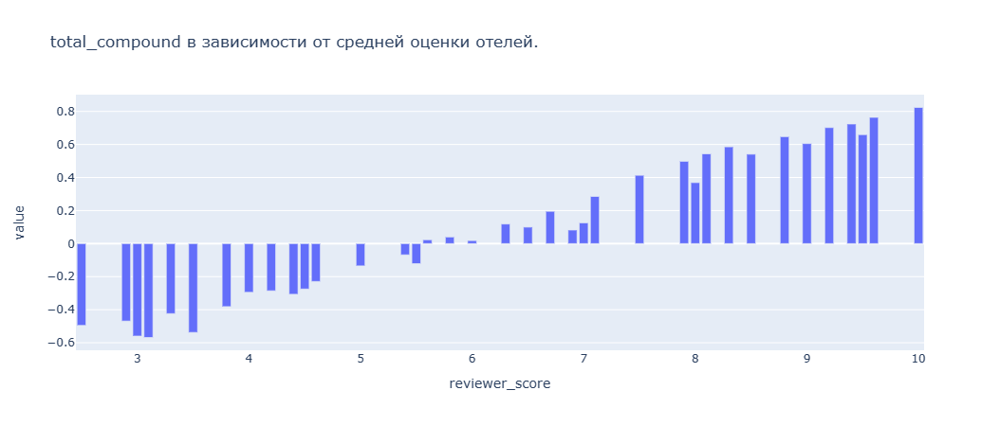

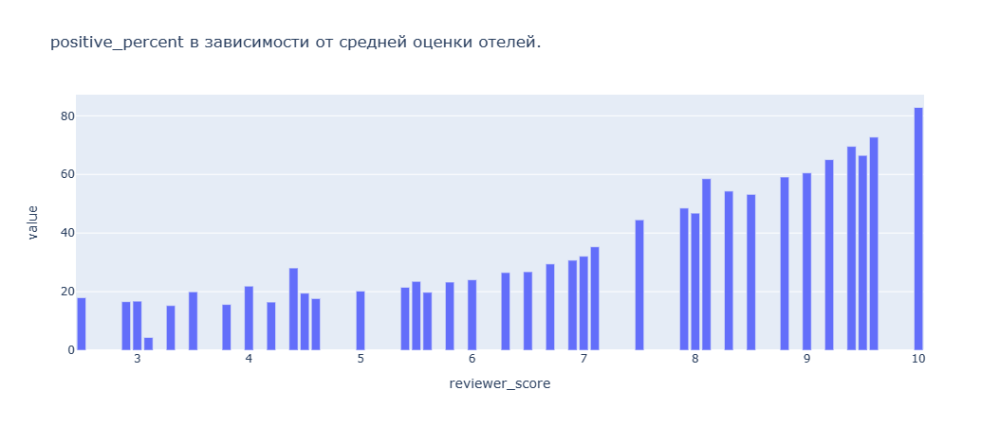

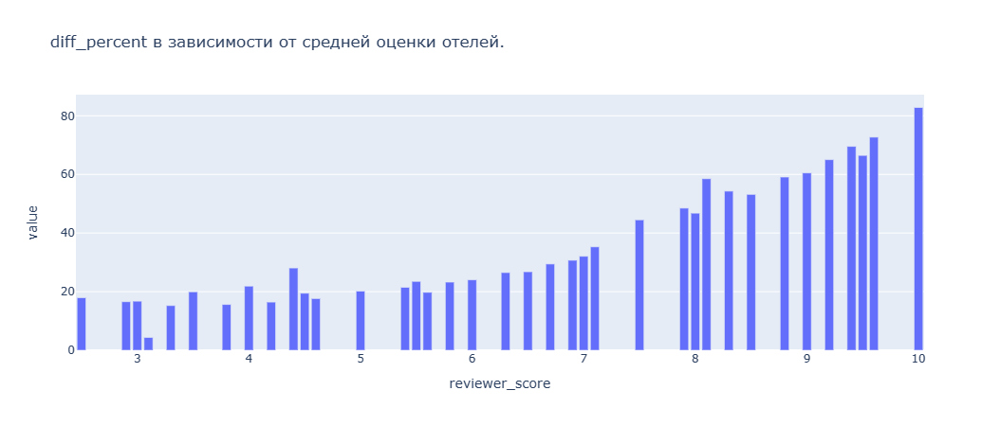

In [277]:
for feature in ['total_compound', 'positive_percent', 'diff_percent']:
    # сводная таблица  
    piv_nation = pd.pivot_table(
                        data[(data['sample']==1) & (data['room_type'].isin(room_list)) ],
                        values=feature,
                        index='reviewer_score',
                        aggfunc='mean',
                        )

    # Визуализируем зависимость средней оценки 
    fig = px.bar(
        data_frame=piv_nation,
        title=f'{feature} в зависимости от cредней оценки отелей.',
        width=900,
    )
    fig.update_layout(showlegend = False) 
    fig.show()  


Зависимость определенно есть, сгенерированные признаки сильно улучшили метрику.

---

# Анализ  и очистка выбросов.

Визуализируем распределения для числовых признаков в обычном и лог масштабе. 

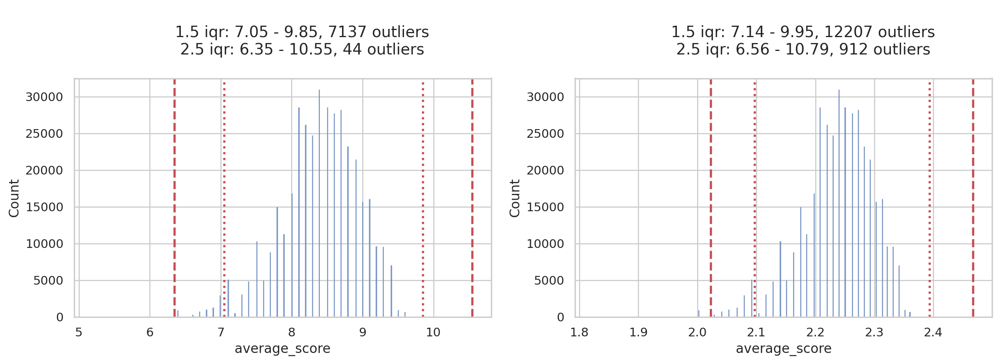

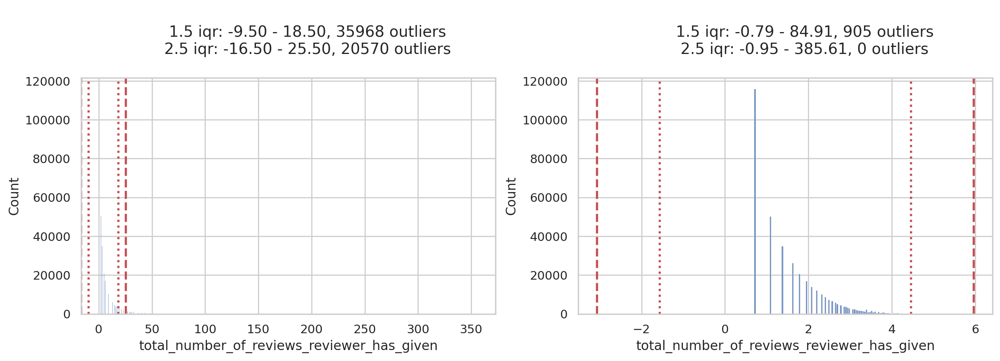

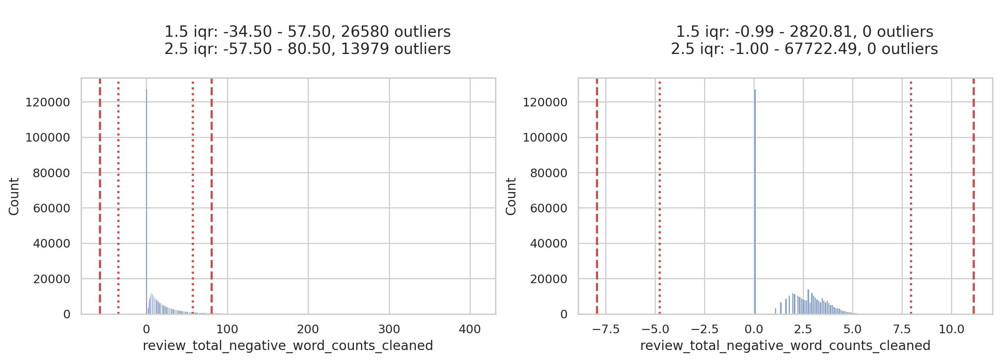

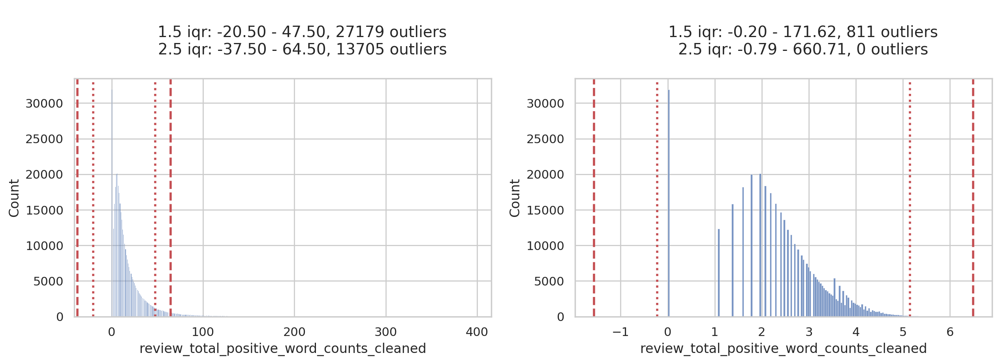

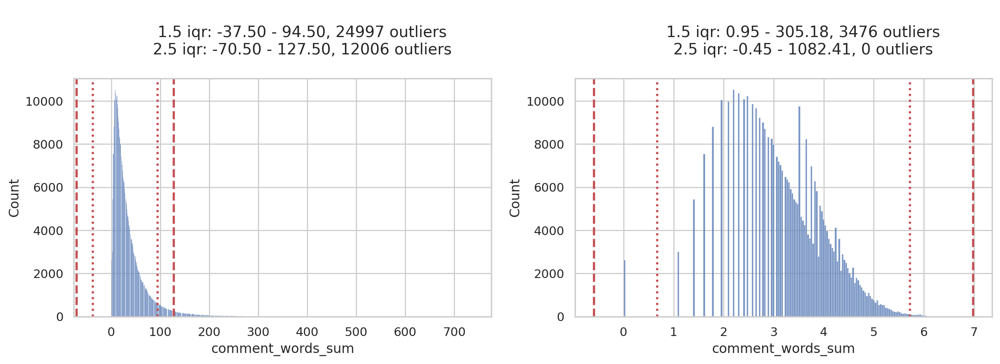

...

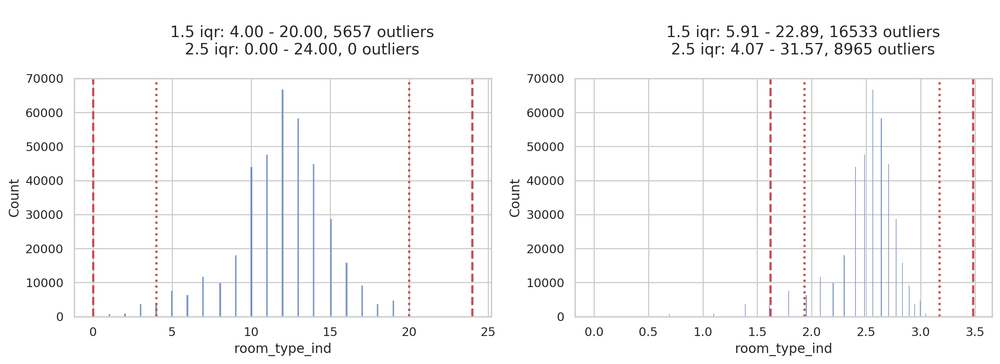

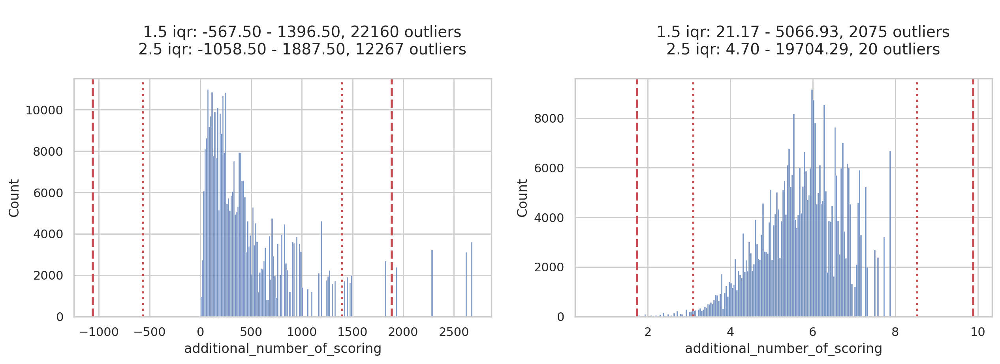

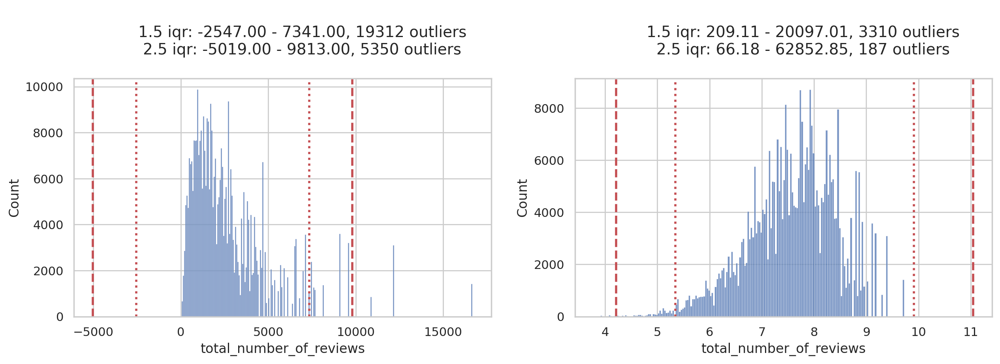

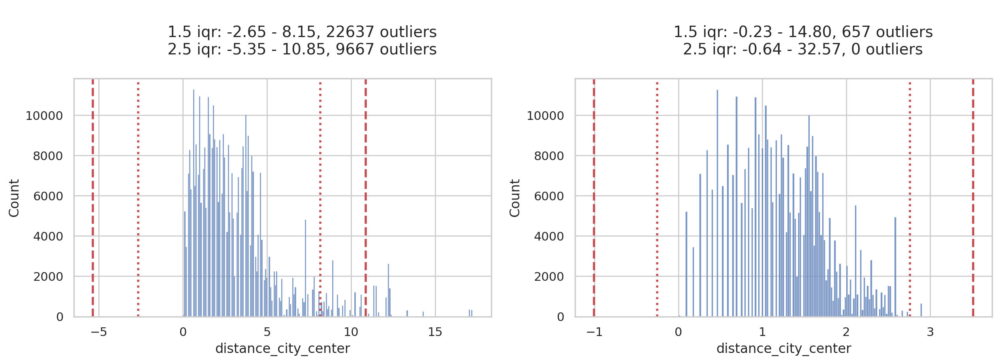

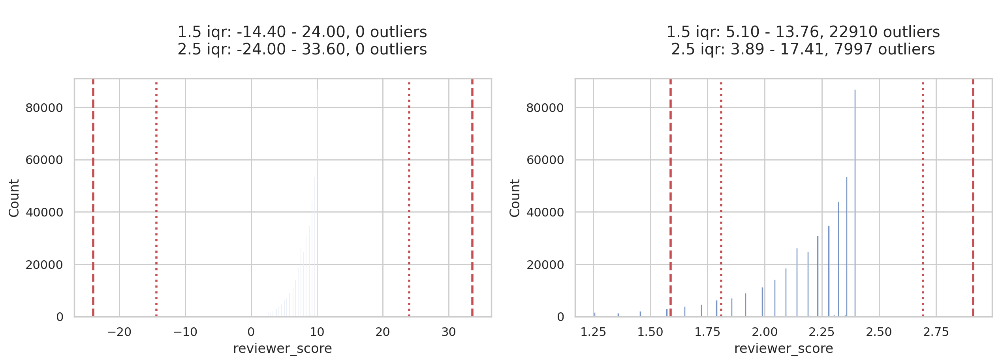

In [278]:
def histo(feature):
    #Строим гистограмму
    fig, axes = plt.subplots(1, 2, figsize=(15, 4))
    train_data =data[data['sample']==1] 
    
    hist1 = sns.histplot(data=train_data, x=feature, ax=axes[0]);
    feature_data = data[feature]
    #Добавляем вертикальные линии для границ метода IQR
    
    quartile_1, quartile_3 = feature_data.quantile(0.25), feature_data.quantile(0.75),
    iqr = quartile_3 - quartile_1
    lower_bound = quartile_1 - 1.5*iqr
    upper_bound = quartile_3 + 1.5*iqr
    lower_bound2 = quartile_1 - 2.5*iqr
    upper_bound2 = quartile_3 + 2.5*iqr
    axes[0].axvline(upper_bound, color='r', ls=':', lw=2)
    axes[0].axvline(lower_bound, color='r', ls=':', lw=2);
    axes[0].axvline(upper_bound2, color='r', ls='--', lw=2)
    axes[0].axvline(lower_bound2, color='r', ls='--', lw=2);
    
    # Количество потенциальных выбросов
    rows_cnt = train_data[(train_data[feature] < lower_bound) | (train_data[feature] > upper_bound)].shape[0]
    rows_cnt_2 = train_data[(train_data[feature] < lower_bound2) | (train_data[feature] > upper_bound2)].shape[0]
    hist1.set_title(f"""
        1.5 iqr: {lower_bound:0.2f} - {upper_bound:0.2f}, {rows_cnt} outliers
        2.5 iqr: {lower_bound2:0.2f} - {upper_bound2:0.2f}, {rows_cnt_2} outliers
    """, fontsize=14)
    
    
    #Логарифмируем
    log_feature = np.log(train_data[feature]+1)
    #Строим гистограмму в лог. масштабе
    hist2 = sns.histplot(data=log_feature, ax=axes[1]);
    #Добавляем вертикальные линии для границ метода IQR
    quartile_1, quartile_3 = log_feature.quantile(0.25), log_feature.quantile(0.75),
    iqr = quartile_3 - quartile_1
    log_lower_bound = quartile_1 - 1.5*iqr
    log_upper_bound = quartile_3 + 1.5*iqr
    log_lower_bound2 = quartile_1 - 2.5*iqr
    log_upper_bound2 = quartile_3 + 2.5*iqr
    axes[1].axvline(log_upper_bound, color='r', ls=':', lw=2)
    axes[1].axvline(log_lower_bound, color='r', ls=':', lw=2);
    axes[1].axvline(log_upper_bound2, color='r', ls='--', lw=2)
    axes[1].axvline(log_lower_bound2, color='r', ls='--', lw=2);
    
    # Количество потенциальных выбросов
    log_rows_cnt = train_data[(train_data[feature] < (np.exp(log_lower_bound)-1)) | (train_data[feature] > (np.exp(log_upper_bound)-1))].shape[0]
    log_rows_cnt_2 = train_data[(train_data[feature] < (np.exp(log_lower_bound2)-1)) | (train_data[feature] > (np.exp(log_upper_bound2)-1))].shape[0]
    hist2.set_title(f"""
        1.5 iqr: {np.exp(log_lower_bound)-1:0.2f} - {np.exp(log_upper_bound)-1:0.2f}, {log_rows_cnt} outliers
        2.5 iqr: {np.exp(log_lower_bound2)-1:0.2f} - {np.exp(log_upper_bound2)-1:0.2f}, {log_rows_cnt_2} outliers
    """, fontsize=14)
    

outliers = [
    'average_score', 'total_number_of_reviews_reviewer_has_given', 'review_total_negative_word_counts_cleaned', 'review_total_positive_word_counts_cleaned', 
    'comment_words_sum', 'days_count', 'room_type_ind', 'additional_number_of_scoring', 'total_number_of_reviews', 'distance_city_center', 'reviewer_score'
]

for outlier in outliers:
    histo(outlier)

Удалим из тестовой выборки  выбросы смягчая некоторые значения.

In [279]:


data_clean = data[(data["average_score"]>=6.35) | (data['sample'] == 0)]
data_clean = data_clean[(data_clean["review_total_negative_word_counts_cleaned"]<=250) | (data_clean['sample'] == 0)]
data_clean = data_clean[(data_clean["review_total_positive_word_counts_cleaned"]<=250) | (data_clean['sample'] == 0)]
data_clean = data_clean[(data_clean["distance_city_center"]<14) | (data_clean['sample'] == 0)]
data_clean = data_clean[(data_clean['total_number_of_reviews_reviewer_has_given']<=100) | (data_clean['sample'] == 0)]
data_clean = data_clean[(data_clean["comment_words_sum"]<300) | (data_clean['sample'] == 0)]

print(f'Было: {data.shape[0]}, стало: {data_clean.shape[0]}')

Было: 515431, стало: 512879


Очистка выбросов по таргету сильно улучшает метрику на test, но сильно ухудшает submission. Подобное было и в прошлом соревнование по продаже авто.

Но мы можем посмотреть на самые редкие оценки и очистить хотя бы их (забегая вперед, это дает положительный результат).

In [280]:
data_clean[data_clean['sample']==1].reviewer_score.value_counts()

10.0    86471
9.6     53265
9.2     43833
8.8     34596
8.3     30694
7.5     25987
7.9     24729
7.1     18372
6.7     13954
6.3     11117
5.8      8835
5.4      6968
5.0      6164
4.6      4556
4.2      3736
3.8      2922
3.3      1987
2.5      1563
2.9      1164
9.5       522
9.0       480
8.0       386
8.5       376
7.0       288
6.5       273
6.0       182
5.5       159
4.5        97
4.0        63
3.5        58
9.4        46
8.1        26
3.0        24
6.9        23
5.6        13
4.4         9
3.1         6
Name: reviewer_score, dtype: int64

In [281]:
strange_scores = [3.0, 3.1, 3.5, 4.0, 4.4, 4.5, 5.5, 5.6, 6.0, 6.5, 6.9, 7.0, 8.0, 8.1, 8.5, 9.0, 9.4, 9.5]

data_clean = data_clean[(~data_clean["reviewer_score"].isin(strange_scores)) | (data_clean['sample'] == 0)]

print(f'Cтало: {data_clean.shape[0]}')

Cтало: 509848


In [282]:
data = data_clean

In [283]:
data_copy11 = data.copy()
data_copy11.head(2)

,hotel_address,additional_number_of_scoring,review_date,average_score,hotel_name,reviewer_nationality,negative_review,review_total_negative_word_counts,total_number_of_reviews,positive_review,...,total_review_sent,positive_review_for_compound_sent,negative_review_for_compound_sent,positive_review_compound,positive_review_pos,positive_review_neg,negative_review_compound,negative_review_pos,negative_review_neg,total_compound
0,Stratton Street Mayfair Westminster Borough London W1J 8LT United Kingdom,581,2/19/2016,8.4,The May Fair Hotel,United Kingdom,leaving,3,1994,staff were amazing,...,"{'neg': 0.0, 'neu': 0.12, 'pos': 0.88, 'compound': 0.9393}","{'neg': 0.0, 'neu': 0.345, 'pos': 0.655, 'compound': 0.5859}","{'neg': 0.0, 'neu': 0.0, 'pos': 1.0, 'compound': 0.8957}",0.5859,0.655,0.0,0.8957,1.0,0.000,0.9393
1,130 134 Southampton Row Camden London WC1B 5AF United Kingdom,299,1/12/2017,8.3,Mercure London Bloomsbury Hotel,United Kingdom,poor breakfast,3,1361,location,...,"{'neg': 0.608, 'neu': 0.392, 'pos': 0.0, 'compound': -0.4767}","{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}","{'neg': 0.756, 'neu': 0.244, 'pos': 0.0, 'compound': -0.4767}",0.0000,0.000,0.0,-0.4767,0.0,0.756,-0.4767


In [284]:
data = data_copy11.copy()

---
# Отбор признаков.

In [285]:
# убираем признаки которые еще не успели обработать, 
# модель на признаках с dtypes "object" обучаться не будет, просто выберим их и удалим
object_columns = [s for s in data.columns if data[s].dtypes == 'object']
data.drop(object_columns, axis = 1, inplace=True)

In [286]:
# list(data.columns)

In [287]:
# числовые признаки
num_cols = [
            'additional_number_of_scoring',
            'average_score',
            'review_total_negative_word_counts',
            'total_number_of_reviews',
            'review_total_positive_word_counts',
            'total_number_of_reviews_reviewer_has_given',
            'reviewer_score',
            'days_since_review',
            'lat',
            'lng',
            'comment_words_diff',
            'comment_words_sum',
            'positive_percent',
            'diff_percent',
            'positive_review_compound',
            'positive_review_pos',
            'positive_review_neg',
            'negative_review_compound',
            'negative_review_pos',
            'negative_review_neg',
            'total_compound',
            'review_total_negative_word_counts_cleaned',
            'review_total_positive_word_counts_cleaned',
            'center_lng',
            'center_lat',
            'distance_city_center',
            
            ]
# категориальные признаки
cat_cols = [ 
             'review_month',
             'review_week_day',
             'review_month_1',
             'review_month_2',
             'review_month_3',
             'review_month_4',
             'review_month_5',
             'review_month_6',
             'review_month_7',
             'review_month_8',
             'review_month_9',
             'review_month_10',
             'review_month_11',
             'review_month_12',
             'review_week_day_1',
             'review_week_day_2',
             'review_week_day_3',
             'review_week_day_4',
             'review_week_day_5',
             'review_week_day_6',
             'review_week_day_7',
             'reviewer_nationality_0',
             'reviewer_nationality_1',
             'reviewer_nationality_2',
             'reviewer_nationality_3',
             'reviewer_nationality_4',
             'reviewer_nationality_5',
             'reviewer_nationality_6',
             'region_1',
             'region_2',
             'region_3',
             'region_4',
             'region_5',
             'region_6',
             'sub-region_1',
             'sub-region_2',
             'sub-region_3',
             'sub-region_4',
             'sub-region_5',
             'sub-region_6',
             'sub-region_7',
             'sub-region_8',
             'sub-region_9',
             'sub-region_10',
             'sub-region_11',
             'sub-region_12',
             'sub-region_13',
             'sub-region_14',
             'sub-region_15',
             'sub-region_16',
             'Business_trip',
             'with_pet',
             'mobile',
             'days_count',
             'group_size_1',
             'group_size_2',
             'group_size_3',
             'group_size_4',
             'group_size_5',
             'group_size_6',
             'room_type_ind',
             'food',
             'staff',
             'room',
             'price',
             'location',
             'is_perfect',
            ]


Посмотрим на значимость.

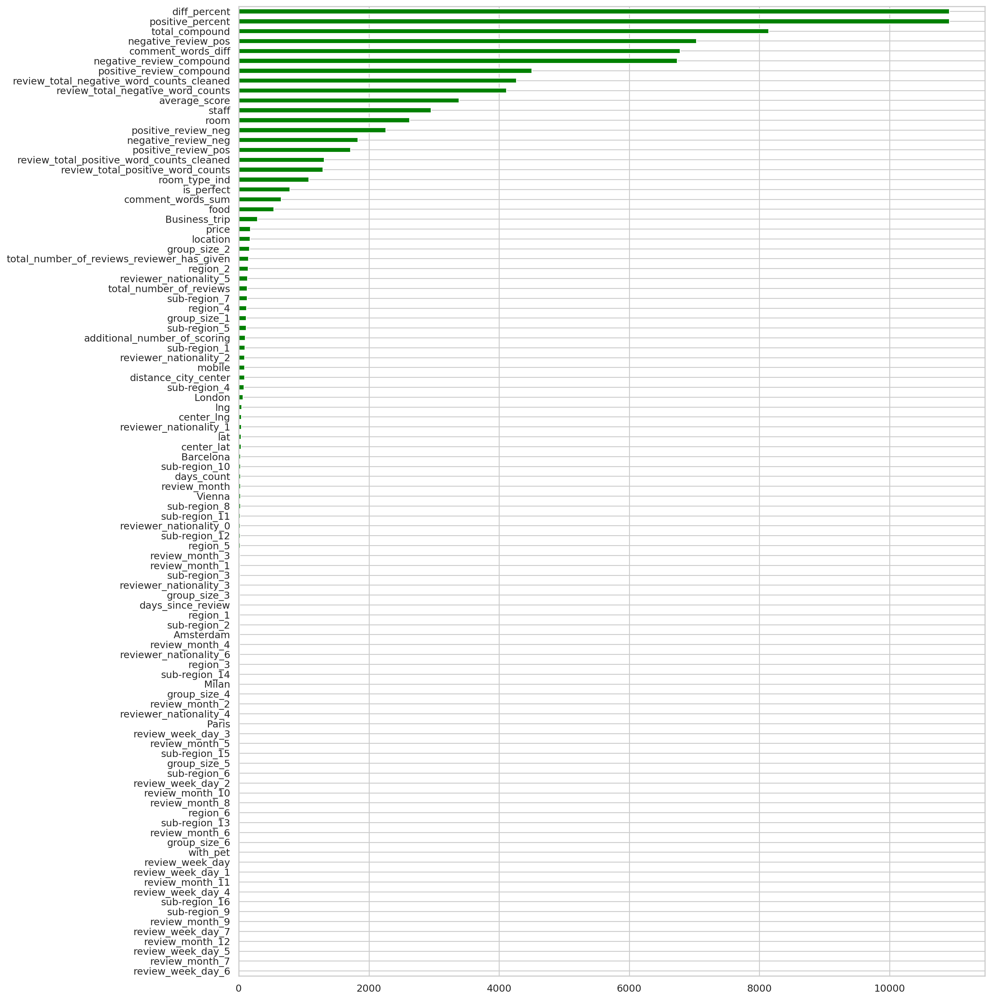

In [288]:
y_pre = data.query('sample == 1').drop(['sample'], axis=1).reviewer_score.values
X_pre = data.query('sample == 1').drop(['sample', 'reviewer_score'], axis=1)

imp_num = pd.Series(f_classif(X_pre[X_pre.columns], y_pre)[0], index = X_pre.columns)
imp_num.sort_values(inplace = True)

fig5, ax5 = plt.subplots(figsize=(15, 20))
imp_num.plot(kind = 'barh', color='green');

Построим матрицу корреляций, так как признаков много, отберем сразу, только те, что с высокой корреляцией с какими то другими признаками.

<AxesSubplot:>

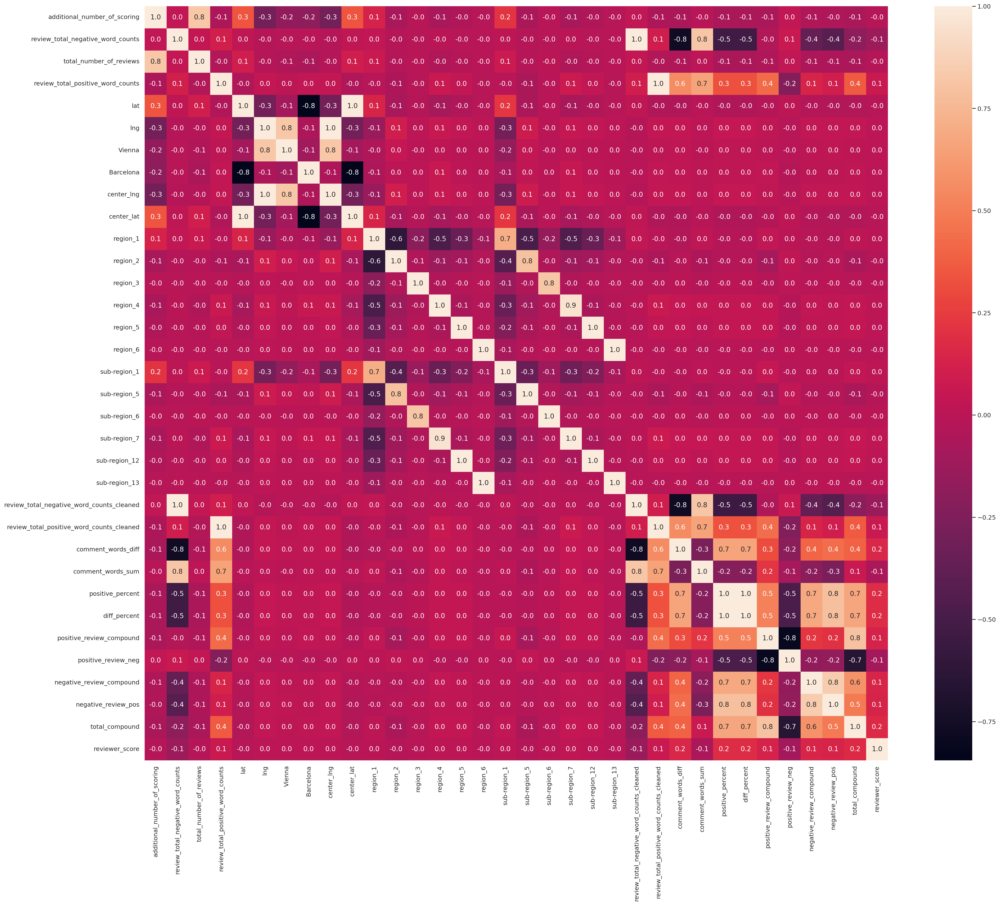

In [289]:
df_corr = data.drop(['sample'], axis=1).corr()
result_columns = []
for column in df_corr:
    col_data = df_corr[column]
    if col_data.min() < -0.7 or col_data.sort_values(ascending=False)[1] > 0.7:
        result_columns.append(column)
result_columns.append('reviewer_score')
        
plt.rcParams['figure.figsize'] = (30,25)
sns.heatmap(data[result_columns].corr(), annot=True, fmt=".1f" )

Я испробовал не один (и не два, и не три...) ) десятка вариантов удаления малозначимых и сильно скоррелированных  признаков, и метрика постоянно оказывалась хуже чем на полном наборе признаков. Поэтому будем считать, что используемые алгоритмы лучше нас умеют отбирать себе признаки.

In [290]:
# drop_columns = []

In [291]:
# drop_columns.append('center_lat')
# drop_columns.append('center_lng')
# drop_columns.append('review_total_positive_word_counts')
# drop_columns.append('review_total_negative_word_counts')

# drop_columns.append('total_number_of_reviews')
# drop_columns.append('additional_number_of_scoring')

# drop_columns.append('lat')
# drop_columns.append('lng')

# # drop_columns.append('sub-region_9')
# drop_columns.append('sub-region_12')
# drop_columns.append('sub-region_13')
# # drop_columns.append('region_6')
# # drop_columns.append('sub-region_6')
# # drop_columns.append('region_3')
# # drop_columns.append('sub-region_15')
# drop_columns.append('sub-region_7')
# drop_columns.append('sub-region_6')
# drop_columns.append('region_1')
# drop_columns.append('sub-region_1')


# drop_columns.append('comment_words_diff') лучше оставить
# drop_columns.append('days_since_review') лучше оставить9

In [292]:
# удалим незначимые данные:
print(f'Удаляем признаков: {len(drop_columns)}')
data.drop(drop_columns, axis = 1, inplace=True)

Удаляем признаков: 0


In [293]:
drop_columns

[]

<AxesSubplot:>

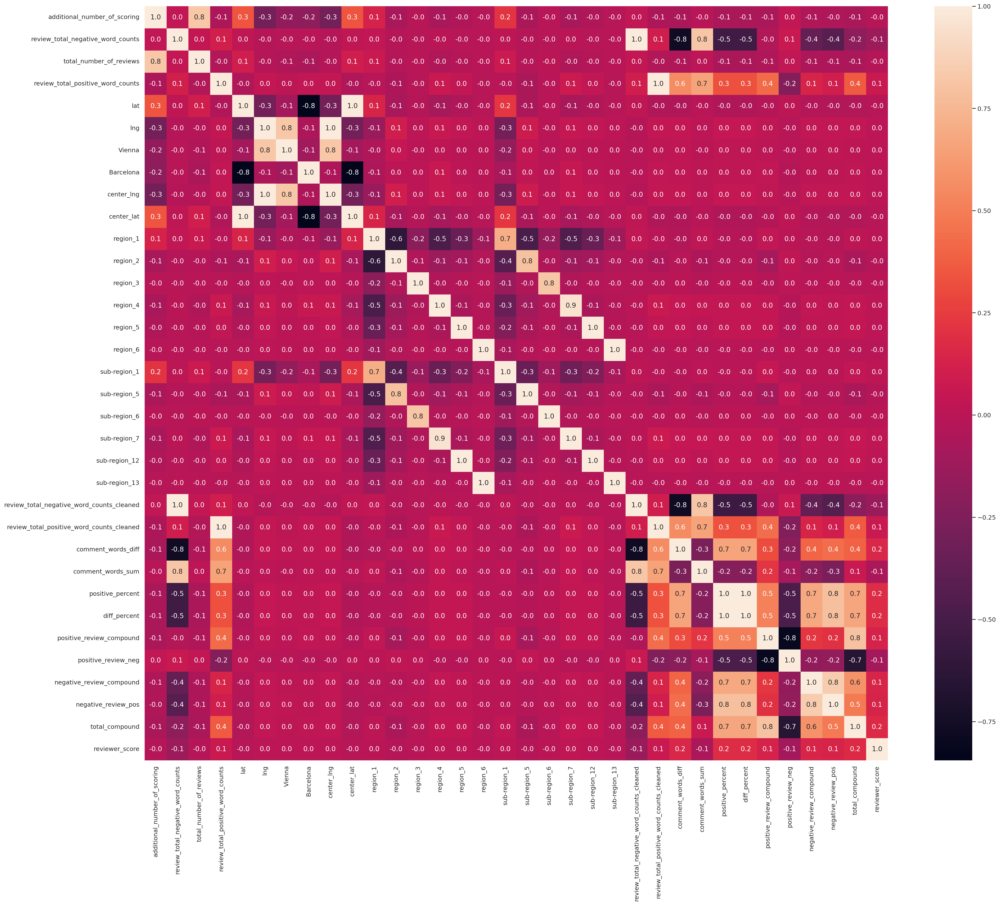

In [294]:
df_corr = data.drop(['sample'], axis=1).corr()
result_columns = []
for column in df_corr:
    col_data = df_corr[column]
    if col_data.min() < -0.7 or col_data.sort_values(ascending=False)[1] > 0.7:
        result_columns.append(column)
result_columns.append('reviewer_score')
        
plt.rcParams['figure.figsize'] = (30,25)
sns.heatmap(data[result_columns].corr(), annot=True, fmt=".1f" )

In [295]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 509848 entries, 0 to 515430
Data columns (total 100 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   additional_number_of_scoring                509848 non-null  int64  
 1   average_score                               509848 non-null  float64
 2   review_total_negative_word_counts           509848 non-null  int64  
 3   total_number_of_reviews                     509848 non-null  int64  
 4   review_total_positive_word_counts           509848 non-null  int64  
 5   total_number_of_reviews_reviewer_has_given  509848 non-null  int64  
 6   reviewer_score                              509848 non-null  float64
 7   days_since_review                           509848 non-null  int64  
 8   lat                                         509848 non-null  float64
 9   lng                                         509848 non-null  float64


# Обучение моделей и получение предсказаний

In [315]:
# Теперь выделим тестовую часть
train_data = data.query('sample == 1').drop(['sample'], axis=1)
test_data = data.query('sample == 0').drop(['sample'], axis=1)

y = train_data.reviewer_score.values            # наш таргет
X = train_data.drop(['reviewer_score'], axis=1)

# Воспользуемся специальной функцие train_test_split для разбивки тестовых данных
# выделим 20% данных на валидацию (параметр test_size)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=RANDOM_SEED)
# проверяем
test_data.shape, train_data.shape, X.shape, X_train.shape, X_test.shape
# Создаём модель (НАСТРОЙКИ НЕ ТРОГАЕМ)
model = RandomForestRegressor(n_estimators=100,
                              verbose=1,
                              n_jobs=-1,
                              random_state=RANDOM_SEED)

In [316]:
# Масштабируем признаки
ss = StandardScaler()
X_train = ss.fit_transform(X_train)
X_test = ss.transform(X_test)

In [308]:
%%time

# Обучаем модель на тестовом наборе данных
model.fit(X_train, y_train)

# Используем обученную модель для предсказания рейтинга ресторанов в тестовой выборке.
# Предсказанные значения записываем в переменную y_pred
y_pred = model.predict(X_test)

# Сравниваем предсказанные значения (y_pred) с реальными (y_test), и смотрим насколько они в среднем отличаются
random_forest = round(metrics.mean_absolute_percentage_error(y_test, y_pred) * 100, 4)
print('MAPE:', Fore.GREEN, random_forest, Fore.BLACK)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:  3.0min
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  6.8min finished
[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.9s


MAPE:  11.7794 
CPU times: user 26min 28s, sys: 1.89 s, total: 26min 30s
Wall time: 6min 48s


[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.0s finished


<AxesSubplot:>

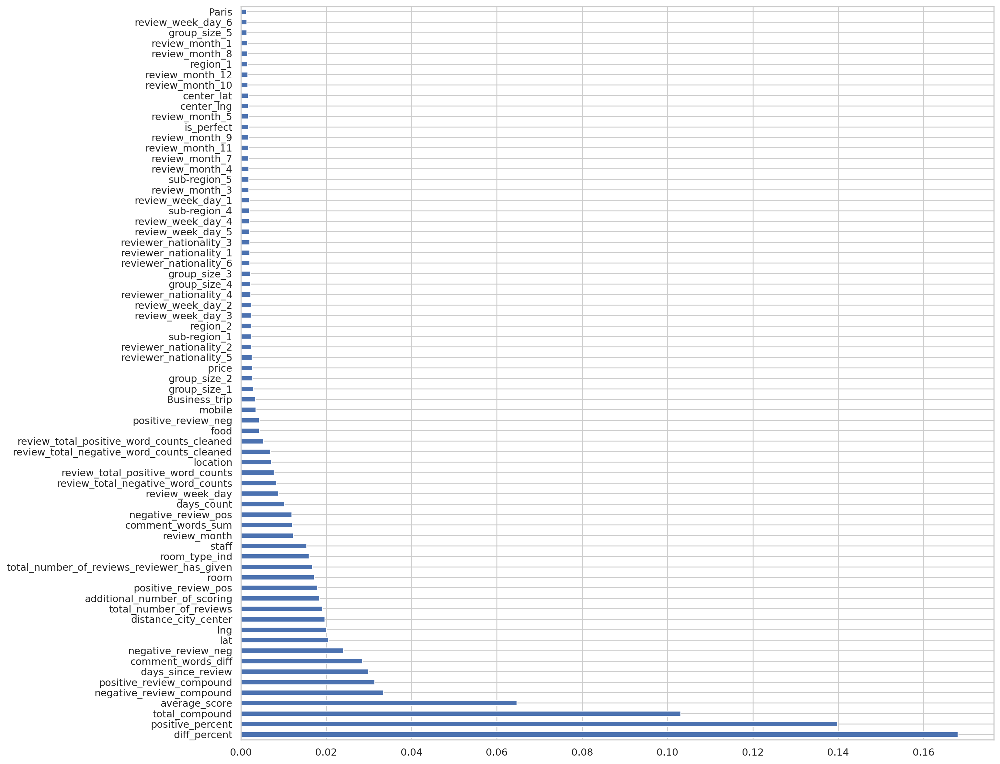

In [309]:
# в RandomForestRegressor есть возможность вывести самые важные признаки для модели
plt.rcParams['figure.figsize'] = (15,15)
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(70).plot(kind='barh')

У меня получилось на RandomForest получить сабмишн чуть меньше 12% (на тесте показатель был порядка 11.7 -11.8 ) и войти в ~ топ 20 на момент работы над ноутбуком (можно было потратить еще десяток другой часов и улучшить метрику, но я так попрактиковался на проекте по продаже автомобилей, чтобы занять 1 место и в этом проекте в голове уже сильно засела фраза из одного юнита данного модуля о том, что надо помнить, а стоят ли временные затраты полученного результата?!), но посмотрев работы из топ 20, видно, что подавляющее большинство использовало не только RandomForest но и другие алгоритмы чтобы получить лучший результат. С одной стороны, что не запрещено - то разрешено) с другой, я до последнего честно работал над проектом, используя только "Случайный лес", но в конце стало просто интересно какие результаты выдаст моя работа при использовании например CatBoostRegressor в сравнение с другими. (В итоге на момент работы получилось 6 место. с submission MAPE 11.52403)

In [310]:
%%time
model2 = CatBoostRegressor(
    iterations=12000, 
    learning_rate=.1, 
    depth=3,
    # task_type="GPU",
    task_type="CPU",
    devices='0:1',
    silent = True
)


# Fit model
model2.fit(X_train, y_train)
# Get predictions
y_pred = model2.predict(X_test)

cat_boost = round(metrics.mean_absolute_percentage_error(y_test, y_pred) * 100, 4)
print('Результат MAPE:',  Fore.GREEN, cat_boost,  Fore.BLACK)

Результат MAPE:  11.2998 
CPU times: user 29min 2s, sys: 34.1 s, total: 29min 36s
Wall time: 7min 49s


In [317]:
test_data = test_data.drop(['reviewer_score'], axis=1)
test_data = ss.transform(test_data)
predict_submission = model2.predict(test_data)
predict_submission

array([8.88877309, 7.92306653, 8.37081735, ..., 8.21941862, 9.58354533,
       7.52830147])

In [318]:
sample_submission['reviewer_score'] = predict_submission


Рейтинг не может быть выше 10, поэтому все оценки выше меняем на 10 Аналогично рейтинг не может быть ниже 0,однако минимум у нас 2.5 поэтому все оценки ниже меняем на 2.5. Так же, у нас таргет округлен по сути до десятых, пробовал округлять, метрика чуть падает, оставим как есть.


In [319]:
sample_submission['reviewer_score'] = sample_submission['reviewer_score'].apply(lambda x : 10 if x > 10 else x)
sample_submission['reviewer_score'] = sample_submission['reviewer_score'].apply(lambda x : 2.5 if x < 2.5 else x)

# sample_submission['reviewer_score'] = sample_submission['reviewer_score'].apply(lambda x : round(x,1))

In [320]:
sample_submission.to_csv('submission.csv', index=False)
sample_submission.head(10)

,reviewer_score,id
0,8.888773,488440
1,7.923067,274649
2,8.370817,374688
3,9.683734,404352
4,9.665443,451596
5,8.129970,302161
6,8.231574,317079
7,7.573861,13963
8,8.757247,159785
9,7.665551,195089


# Выводы.
Проект хорошо закрепляет знания полученные по EDA, было интересно самому генерировать новые признаки и заполнять пропуски в существующих: получать координаты по адресу, проводить семантический анализ отзывов и т.д.. Однако катастрофически не хватает знаний по тому, как устроены модели ML и что они хотят получать в идеале на вход, поэтому зачастую работа сводилась к перебору гипотез: а что будет с метрикой если я сделаю так, потому, что многие базовые действия описанные в теории по EDA, как оказывается, на наших датасетах и конкретных алгоритмах, наоборот ухудшали результат (например удаление сильно коррел. или незначимых по оценке признаков). На это было потрачено сильно больше времени и сил (как и в случае с прошлым соревнованием по продажи авто, где было потрачено очень много время, чтобы занять первое место), чем по плану дается на этот проект, а в жизни и в реальных бизнес задачах нельзя про него забывать), ведь иногда лучше выйти на рынок в 2 раза быстрее конкурентов,чем получить модель с точностью на 0.1% выше (хотя не отрицаю и обратных ситуаций, например в моделях для медицины). Интересно будет вернуться к данному ноутбуку после модулей по ML и оценить какие же выводы и закономерности полученные в процессе данной работы окажутся правдой, а какие будут опровергнуты.